In [1]:
from scipy.io import loadmat
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import pearsonr
%pip install seaborn
import seaborn as sns
from scipy.signal import correlate
import pandas as pd
from scipy.optimize import curve_fit
from scipy.stats import gaussian_kde
from sklearn.linear_model import Lasso
from sklearn.preprocessing import PolynomialFeatures
from scipy.optimize import minimize
from sklearn.linear_model import ElasticNet
from sklearn.metrics import mean_squared_error
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from IPython.display import display
from scipy.optimize import curve_fit
from scipy.ndimage import gaussian_filter1d
from scipy.stats import linregress




Note: you may need to restart the kernel to use updated packages.


In [2]:

path_to_file = r"C:\Users\Montaña Lopez Parra\OneDrive - Universidad Rey Juan Carlos\Escritorio\TFG\mrclean2\alive_1.mat"
data = loadmat(path_to_file)
print(data.keys())

#nombre de la variable es 'Expression1'
if 'Expression1' in data:
    trajectories = data['Expression1']
    print("Trayectorias cargadas con éxito.")
    print(f"Dimensiones de las trayectorias: {trajectories.shape}")
else:
    print("No se encontró 'Expression1' en el archivo .mat.")

#dimensiones
n_trayectorias, n_pasos, n_dimensiones = trajectories.shape
print(f"Total de trayectorias: {n_trayectorias}, Pasos por trayectoria: {n_pasos}, Dimensiones: {n_dimensiones}")



dict_keys(['__header__', '__version__', '__globals__', 'Expression1'])
Trayectorias cargadas con éxito.
Dimensiones de las trayectorias: (52, 2532, 2)
Total de trayectorias: 52, Pasos por trayectoria: 2532, Dimensiones: 2


In [3]:
dt = 1/250  # Frecuencia de muestreo
cromatin_index = 6
trajectory_x = trajectories[cromatin_index, :, 0]  # Posición X de la cromatina
trajectory_y = trajectories[cromatin_index, :, 1]  # Posición Y de la cromatina
    
    #vector de tiempo
longitud_vector_real = len(trajectory_x)
time = np.linspace(0, (longitud_vector_real - 1) * dt, longitud_vector_real)
# cuantas trayectorias tenemos
n_trayectorias = trajectories.shape[0]
n_puntos = trajectories.shape[1]  # Número de puntos por trayectoria

trajectory_x_first = trajectories[0, :, 0]
t_first = np.linspace(0, len(trajectory_x_first) * dt, len(trajectory_x_first)) 
velocidad_x_first = np.gradient(trajectory_x_first, dt)  
aceleracion_x_first = np.gradient(velocidad_x_first, dt) 

k_B = 1.38e-23  # Boltzmann
T = 300  # Kelvin 


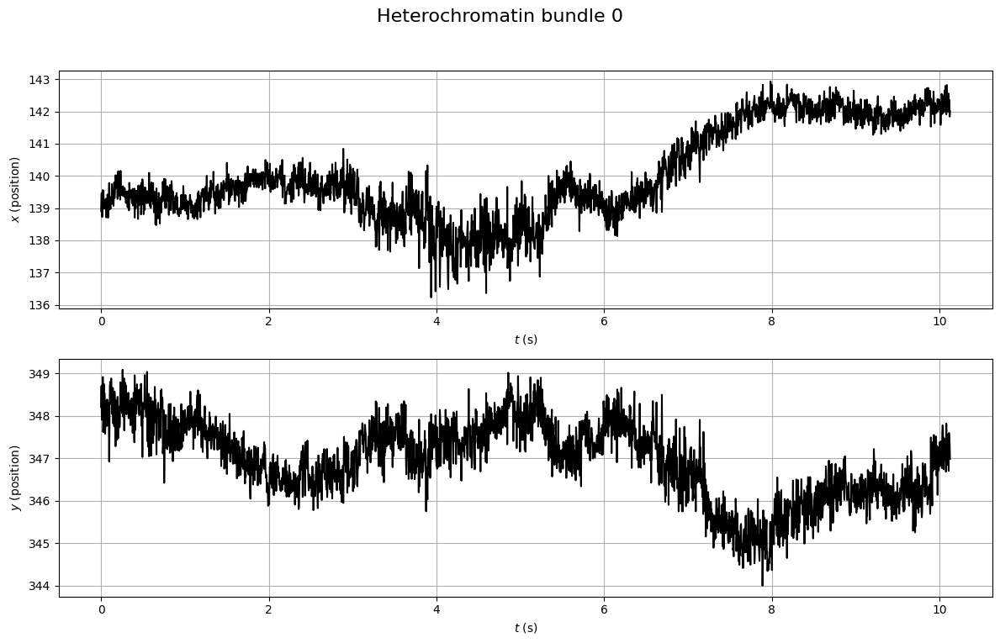

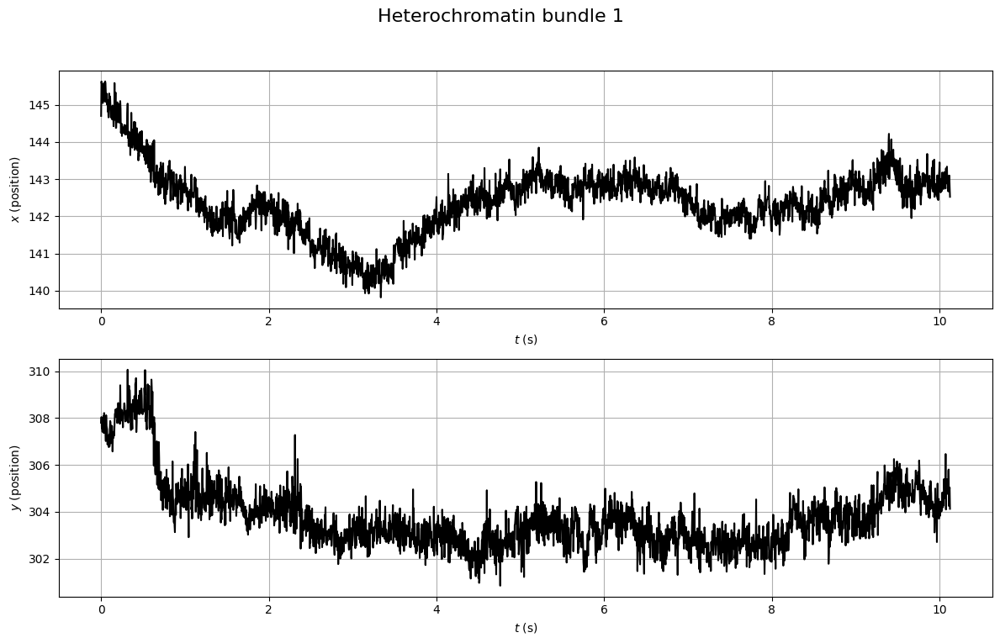

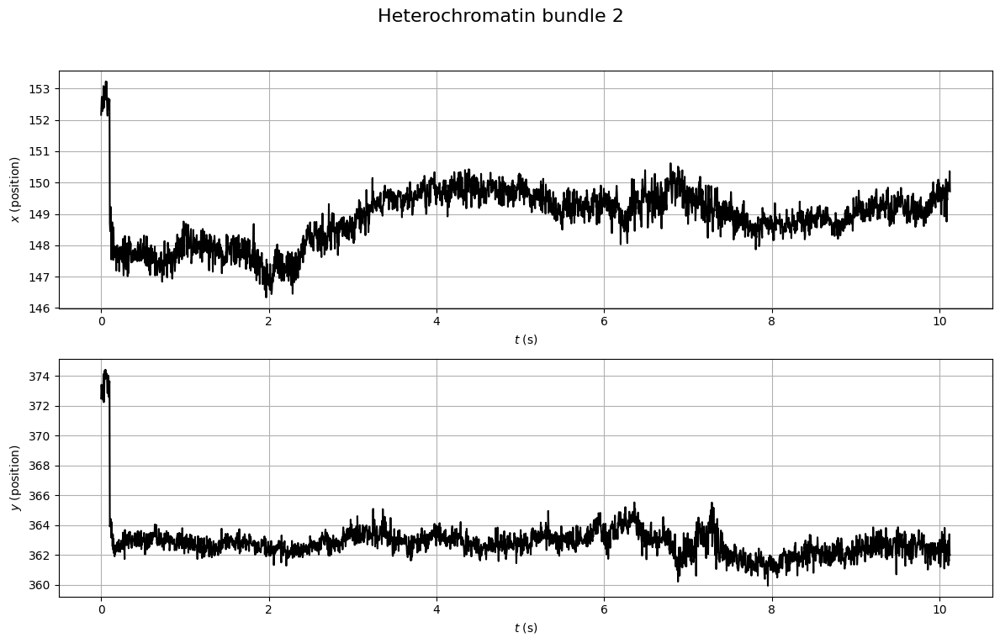

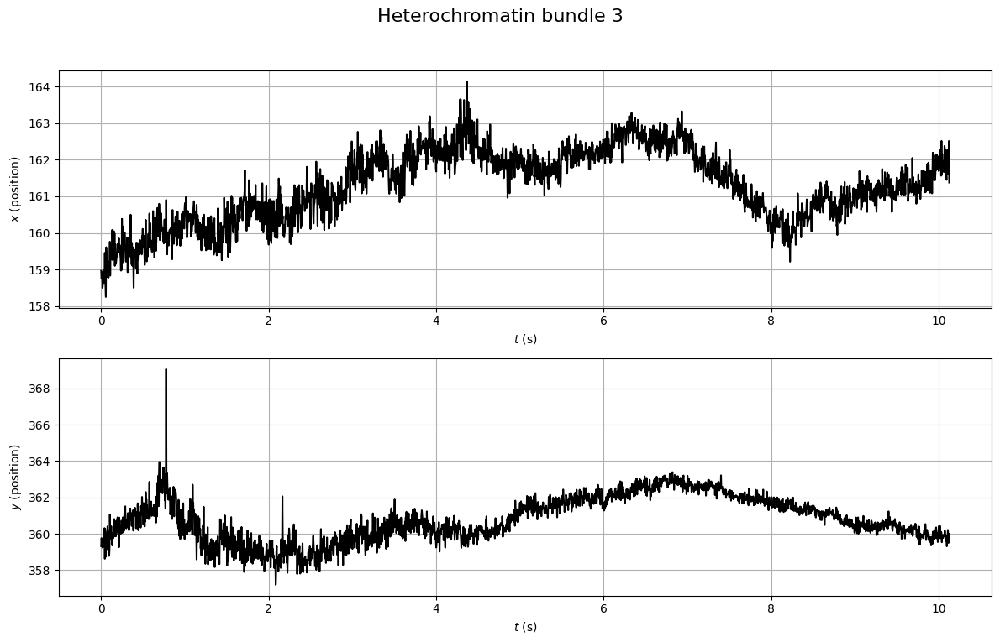

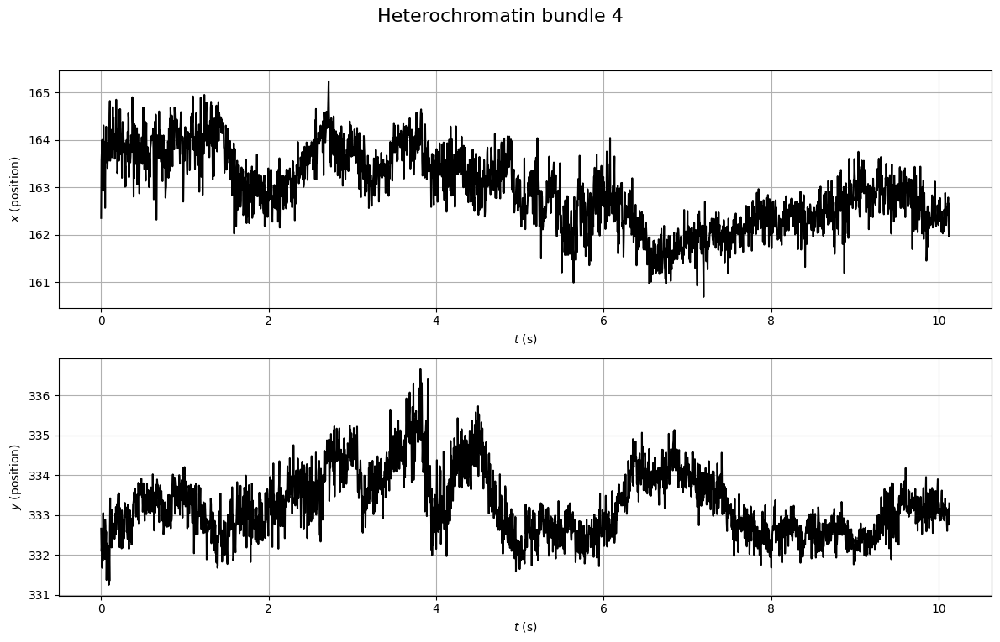

...

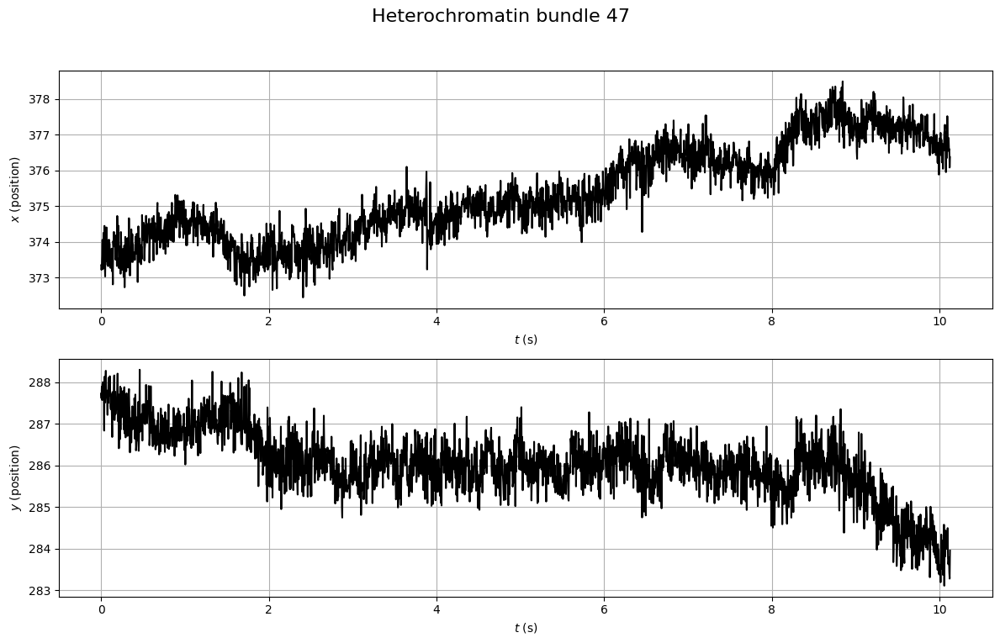

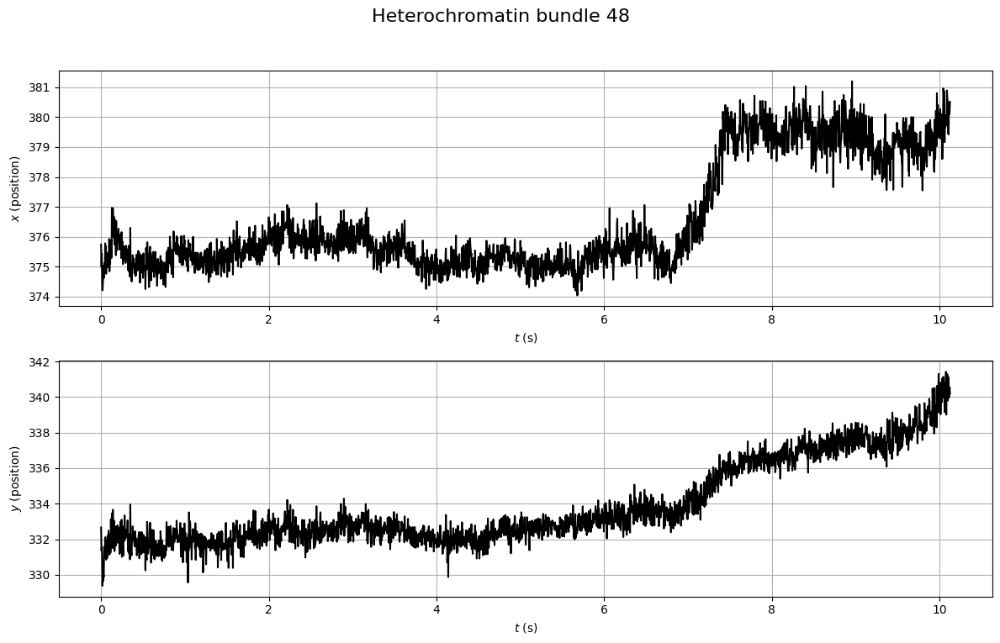

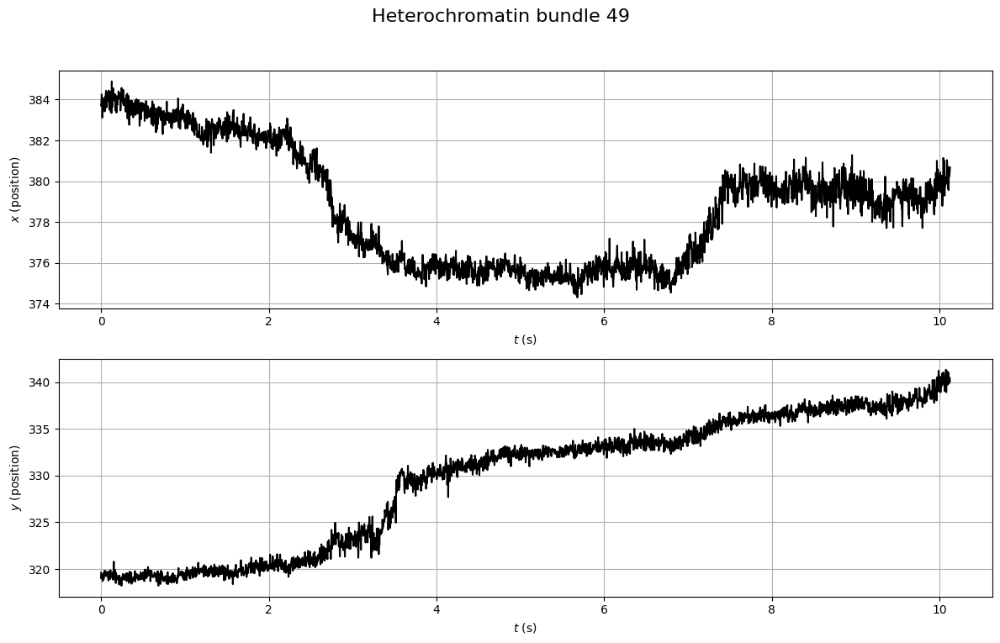

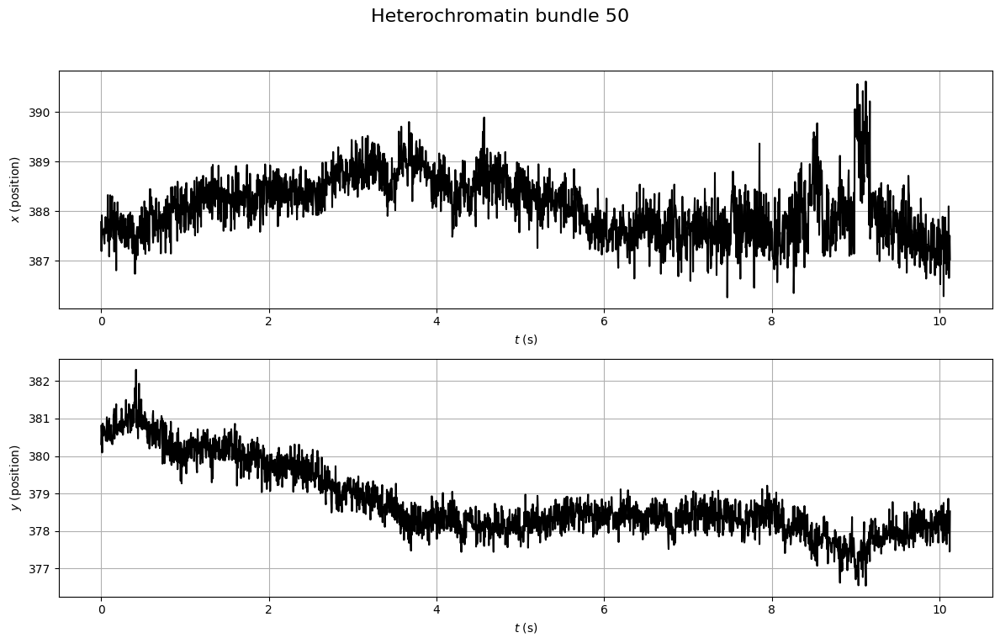

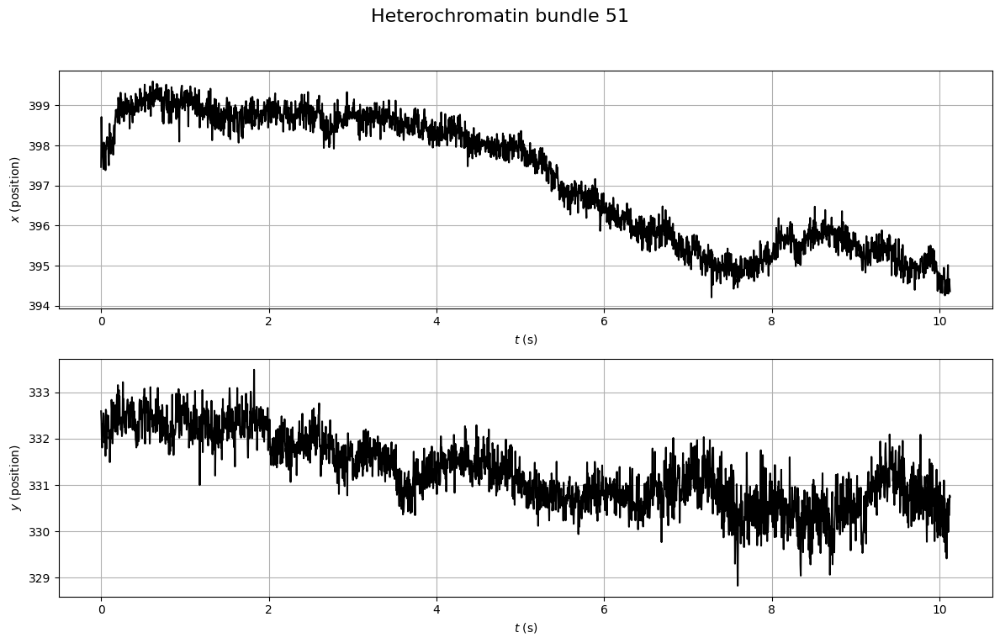

In [4]:
for cromatin in range(n_trayectorias):
    trajectory_x = trajectories[cromatin, :, 0]  # Posición X de la cromatina
    trajectory_y = trajectories[cromatin, :, 1]  # Posición Y de la cromatina
    
    longitud_vector_real = len(trajectory_x)
    time = np.linspace(0, (longitud_vector_real - 1) * dt, longitud_vector_real)
    
    #figura para cada 
    plt.figure(figsize=(12, 8))
    plt.suptitle(f"Heterochromatin bundle {cromatin}", fontsize=16)
    
    plt.subplot(211)
    plt.plot(time, trajectory_x, 'k') #X
    plt.ylabel('$x$ (position)')
    plt.xlabel("$t$ (s)")
    plt.grid()
    
    plt.subplot(212)
    plt.plot(time, trajectory_y, 'k') #Y
    plt.ylabel('$y$ (position)')
    plt.xlabel("$t$ (s)")
    plt.grid()
    
    #figura 
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  
    plt.show()




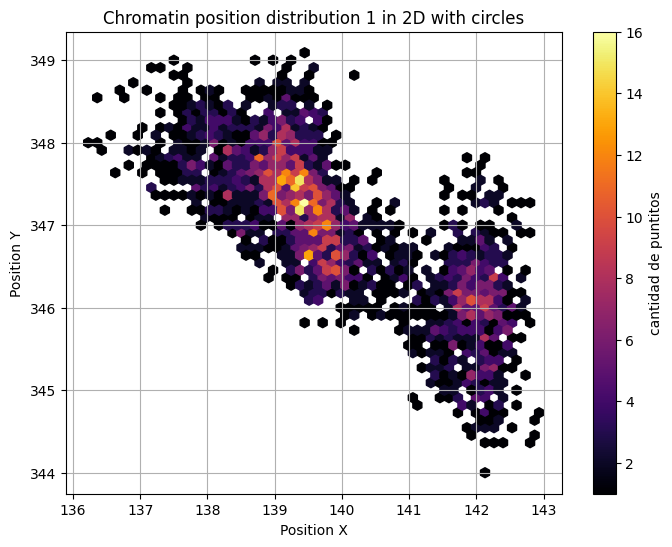

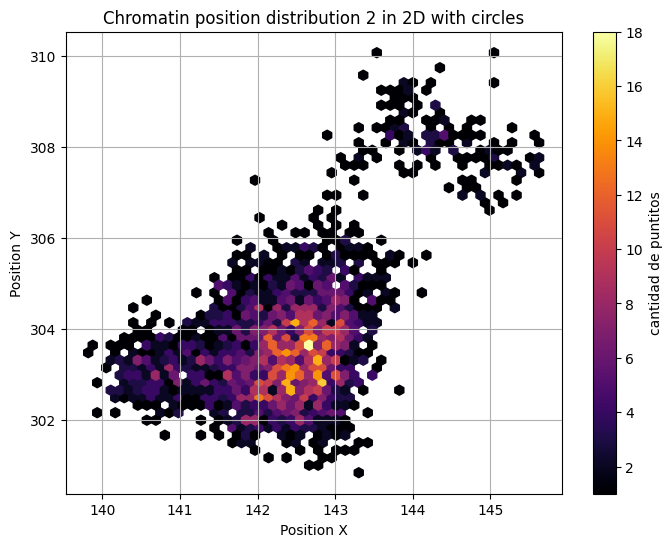

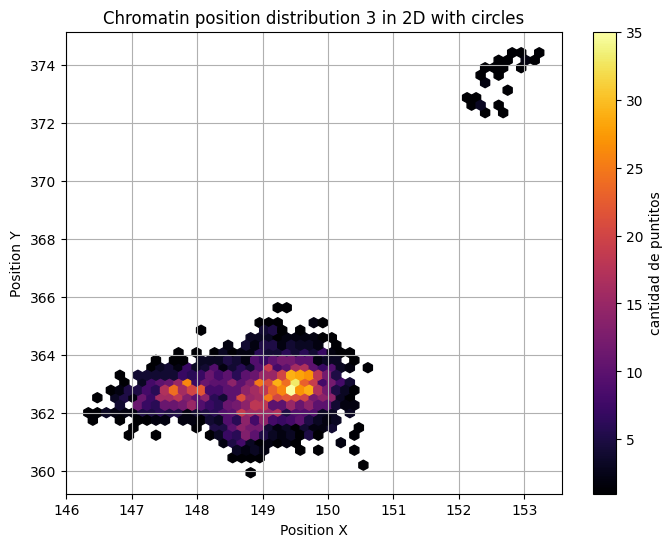

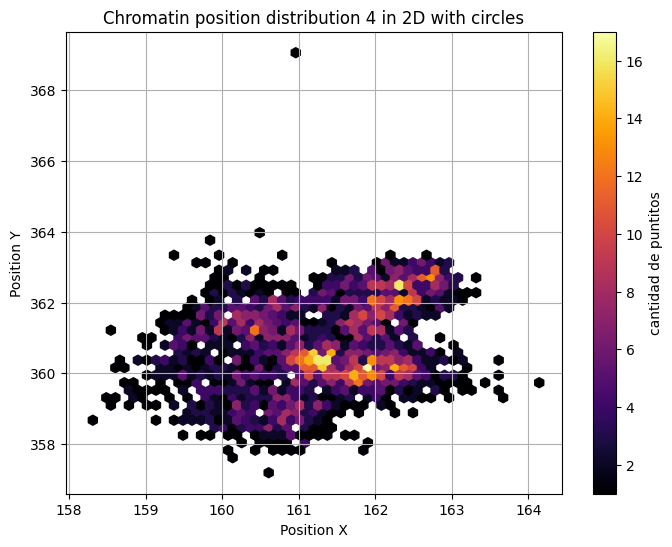

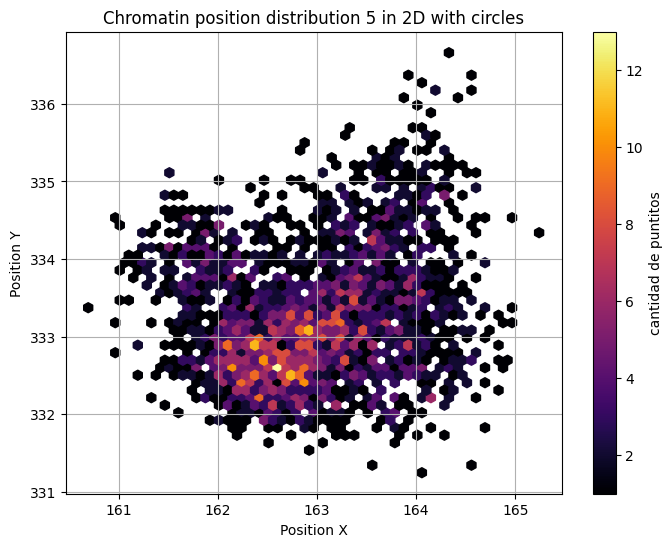

...

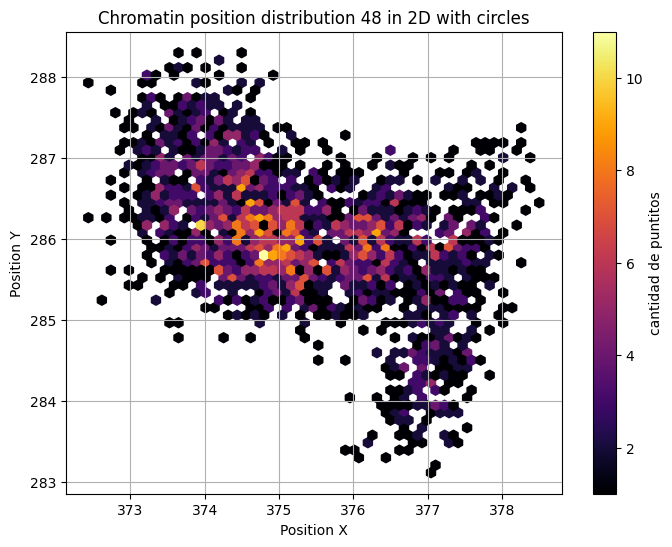

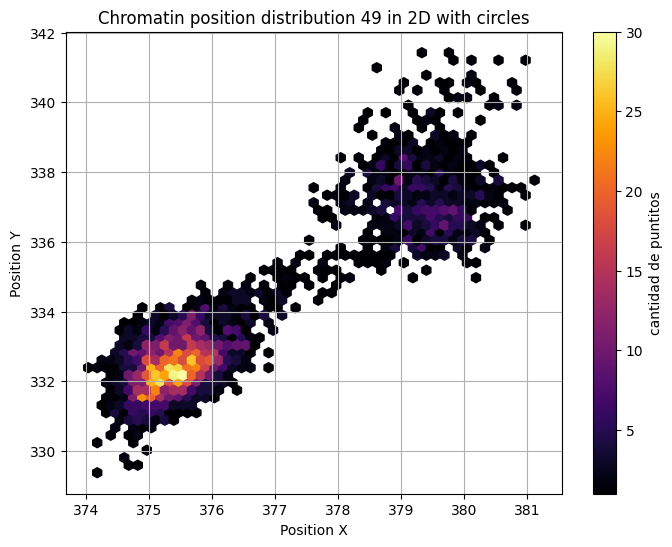

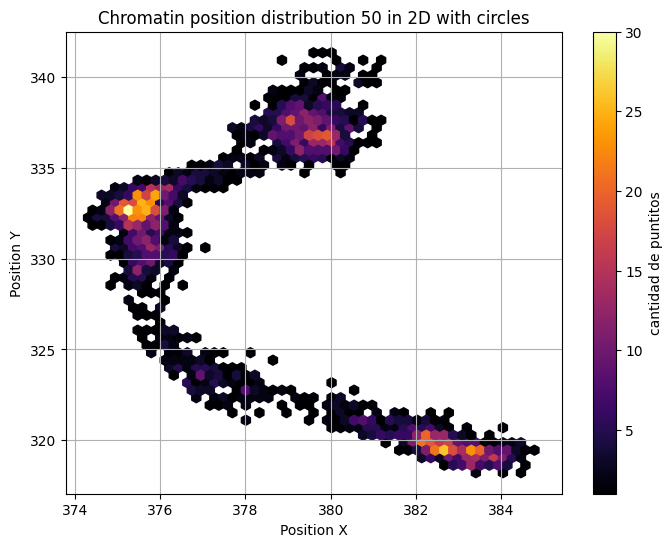

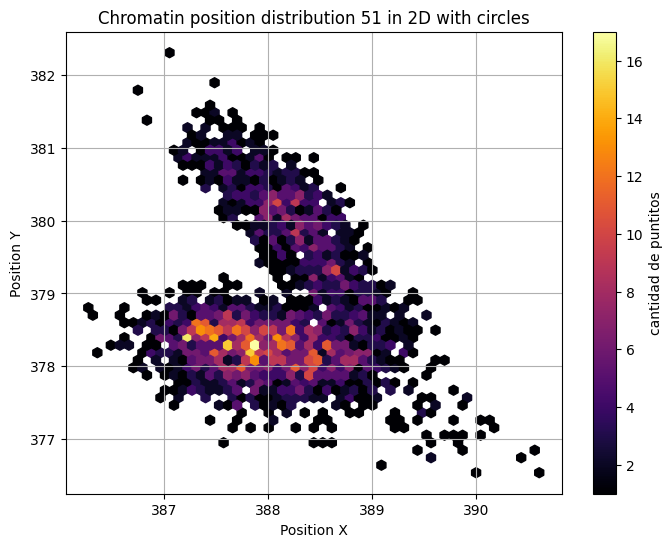

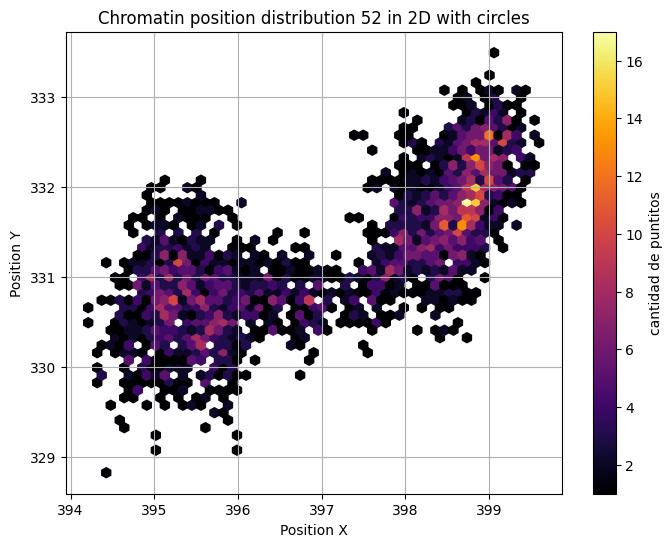

In [5]:
#generacion de otro grafico para que se vea mas clara la distribucion
#LE GUSTA MUCHO LA VISION EN HEX, APLICAR A DISTRIBUCION DE CALLAHAM QUE ESTA EN 1D PARA 2D

for cromatin in range(n_trayectorias):
    trajectory_x = trajectories[cromatin, :, 0]
    trajectory_y = trajectories[cromatin, :, 1]
    plt.figure(figsize=(8, 6))
    
    # Calcular la densidad de probabilidad para cada punto utilizando un histograma 2D
    plt.hexbin(trajectory_x, trajectory_y, gridsize=50, cmap='inferno', mincnt=1)
    
    # colorbaer
    plt.colorbar(label='cantidad de puntitos')
    plt.xlabel('Position X')
    plt.ylabel('Position Y')
    plt.title(f'Chromatin position distribution {cromatin + 1} in 2D with circles')
    plt.grid(True)
    plt.show()



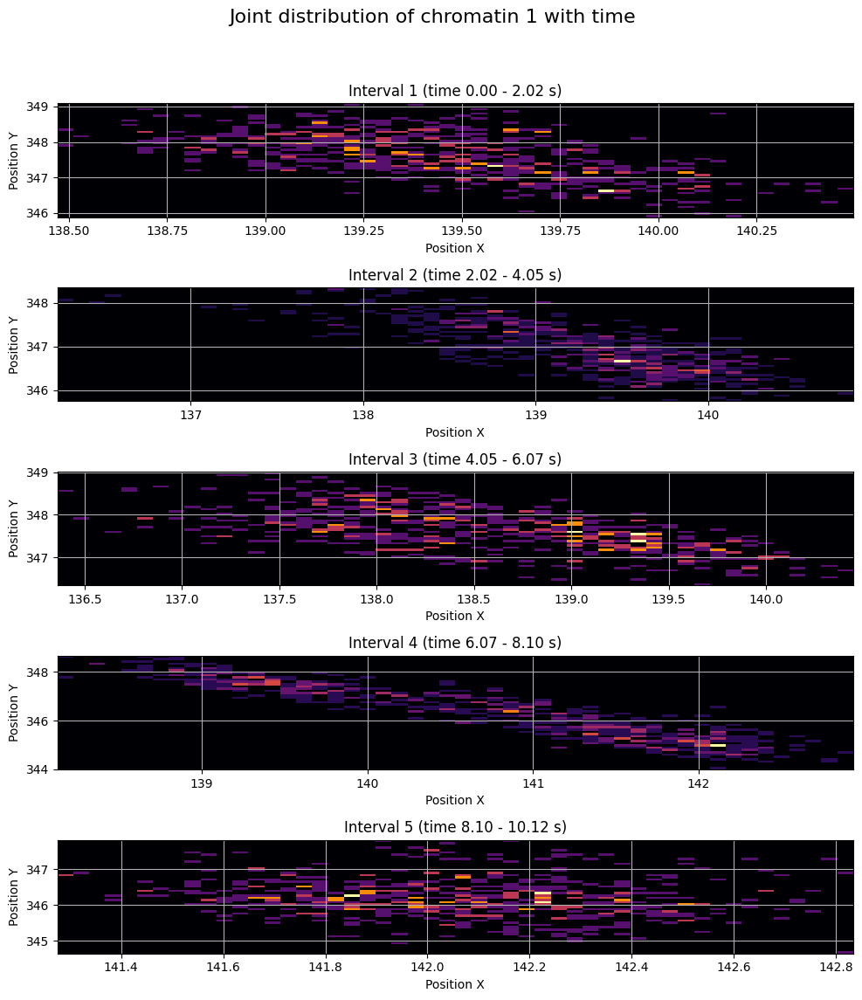

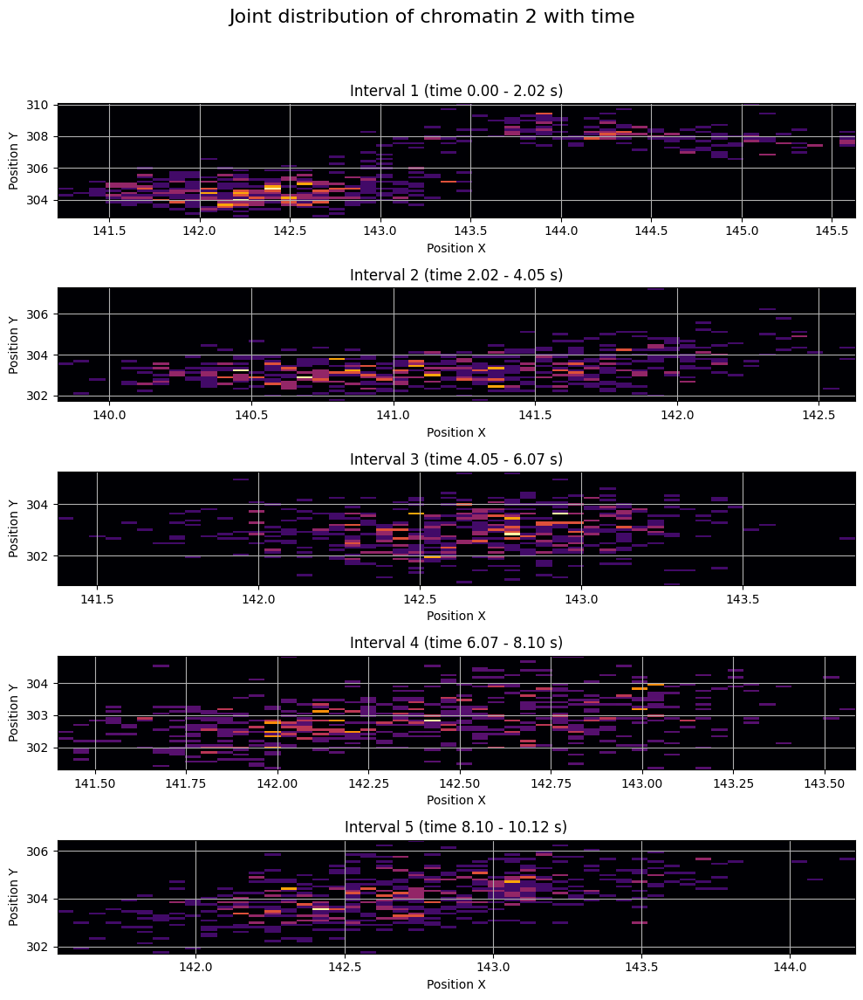

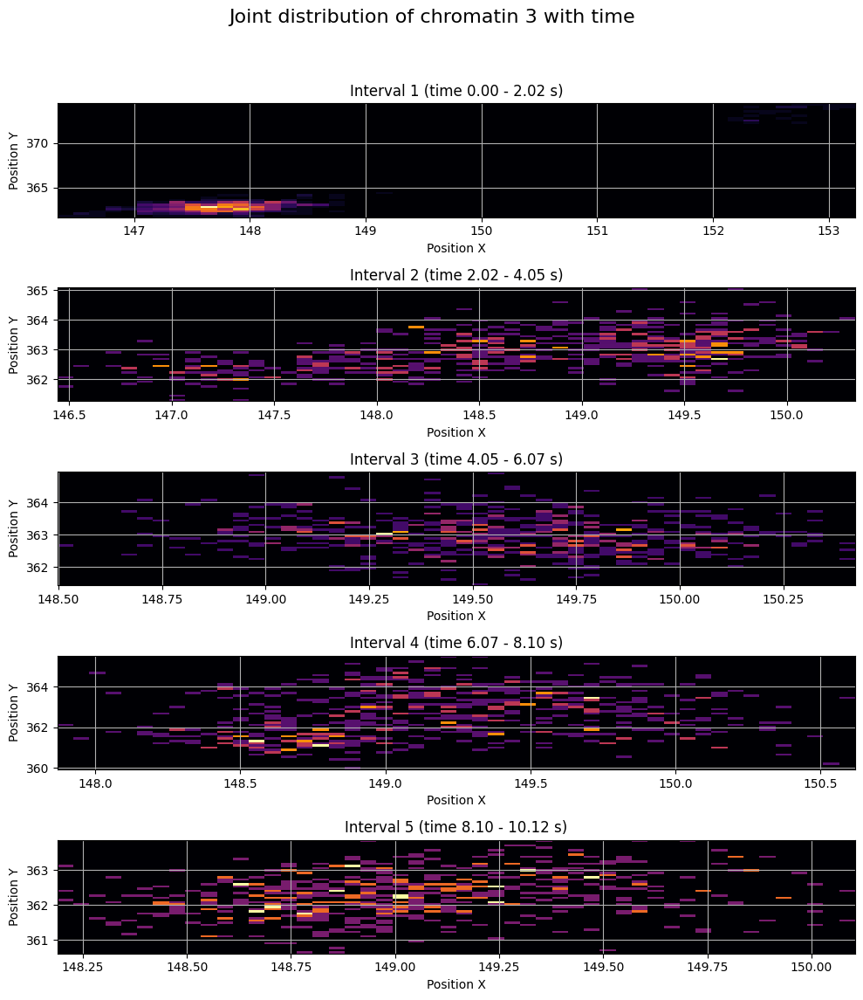

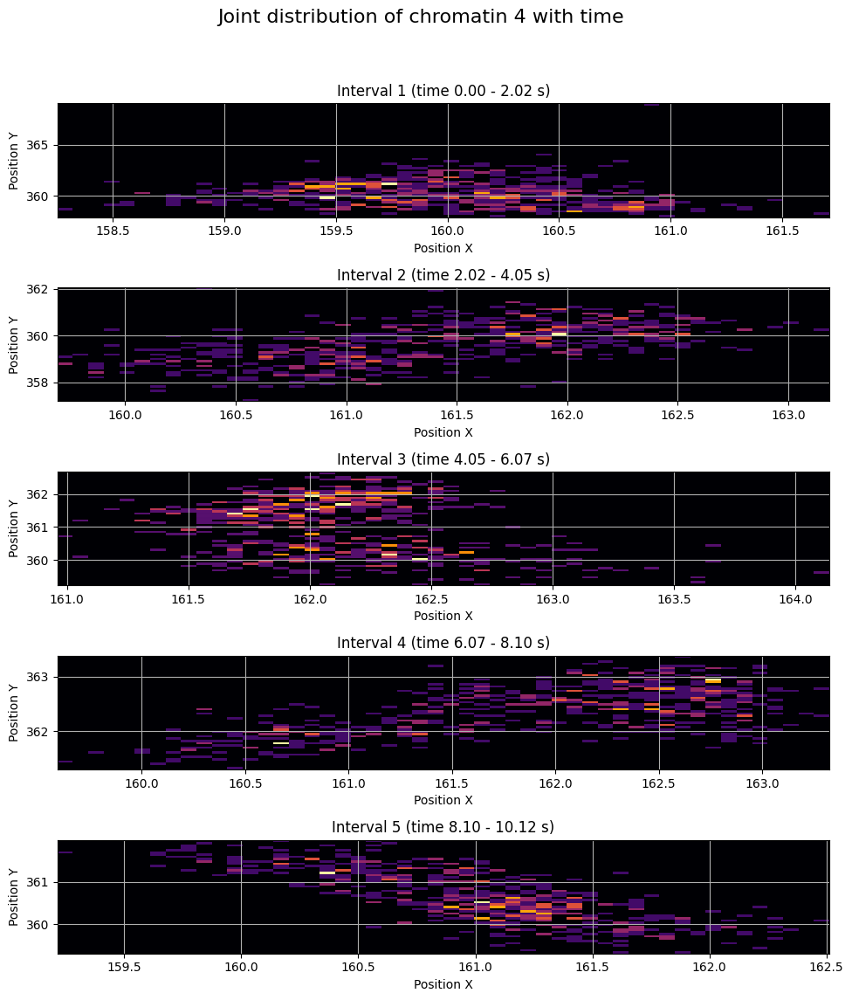

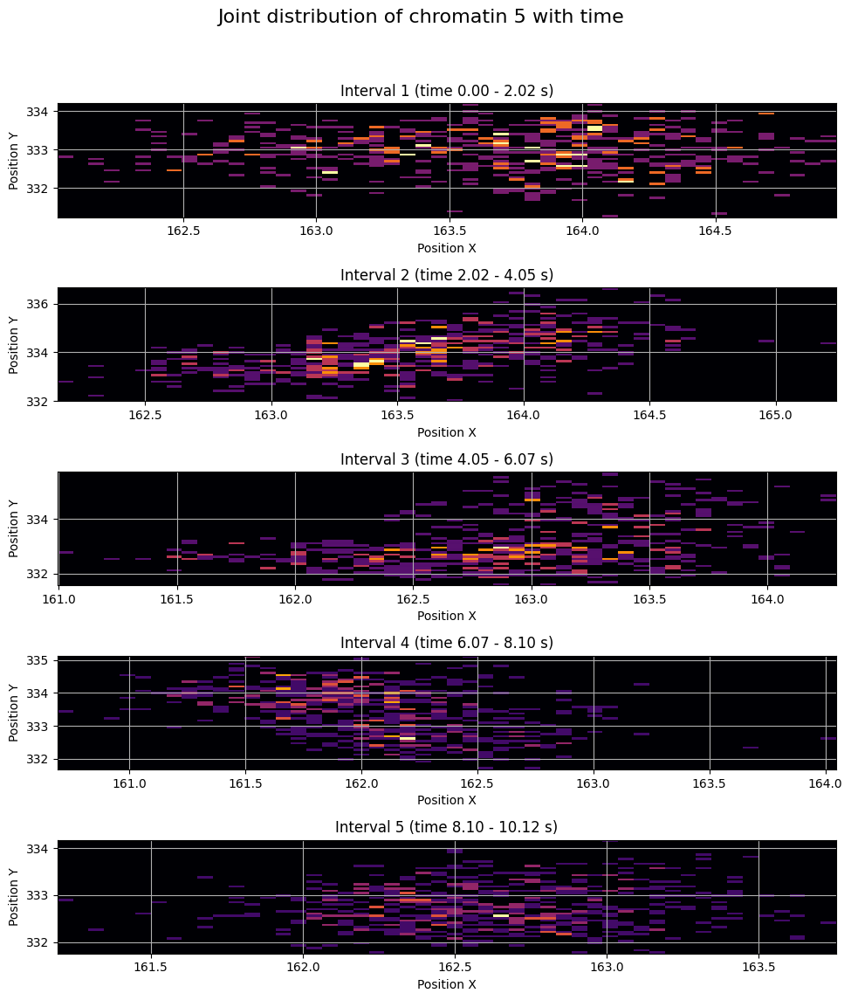

...

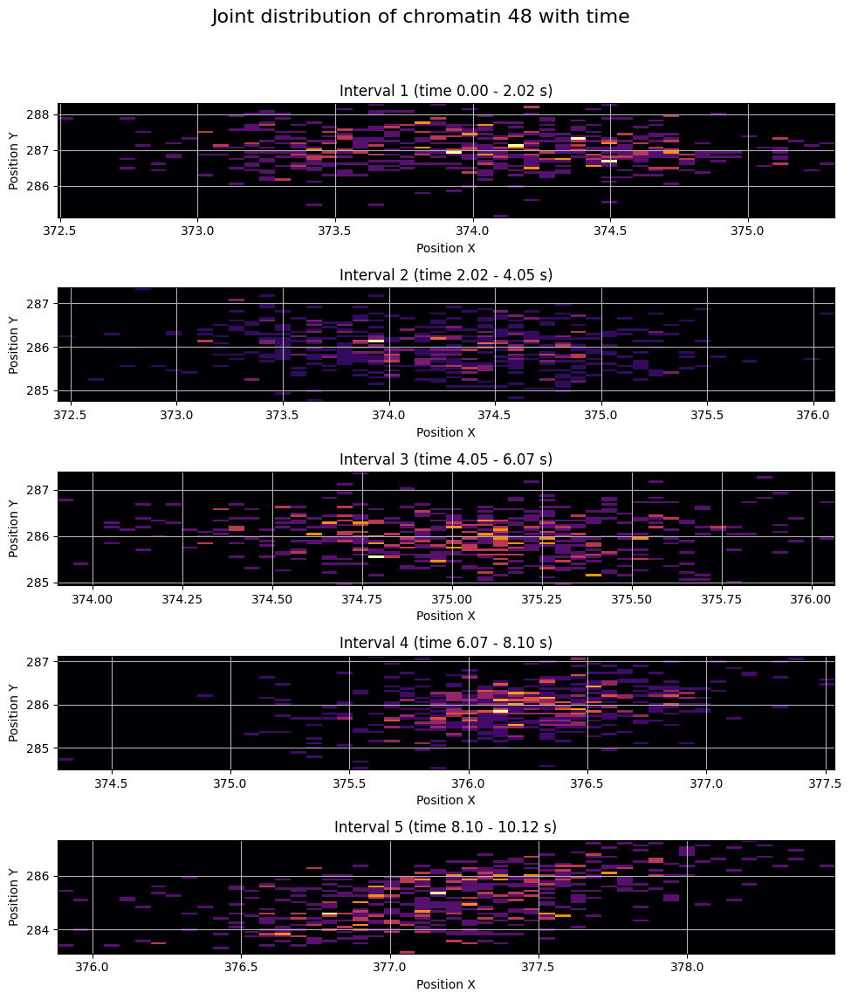

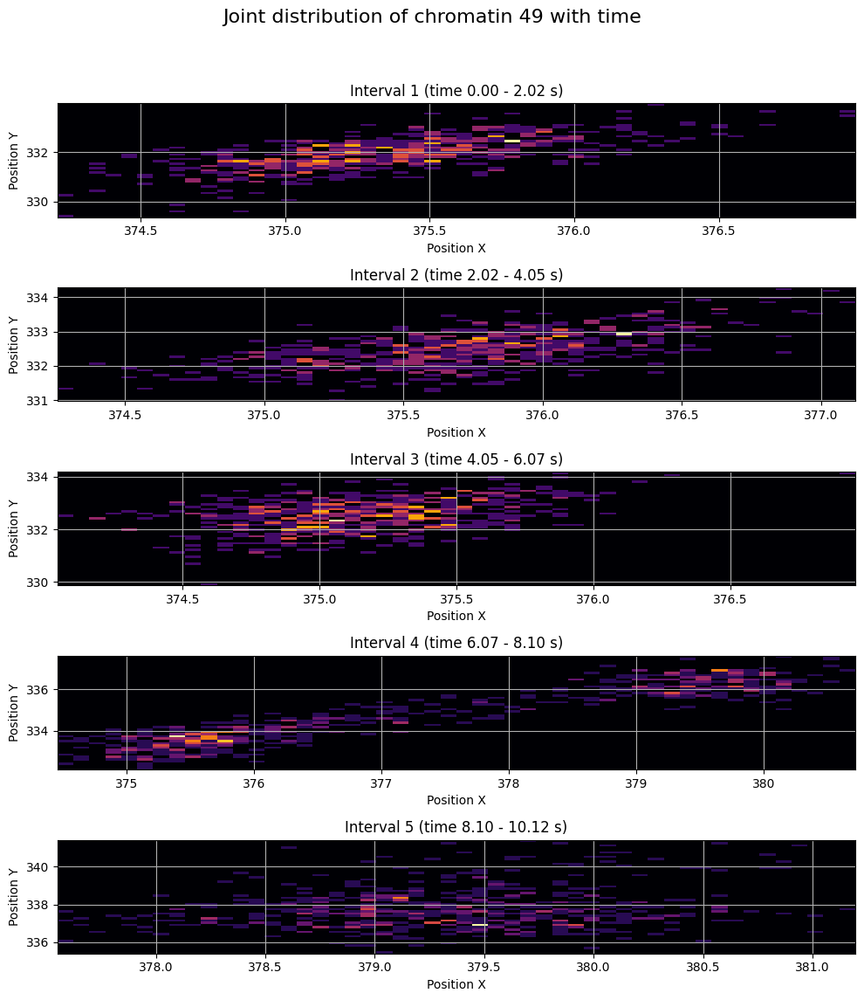

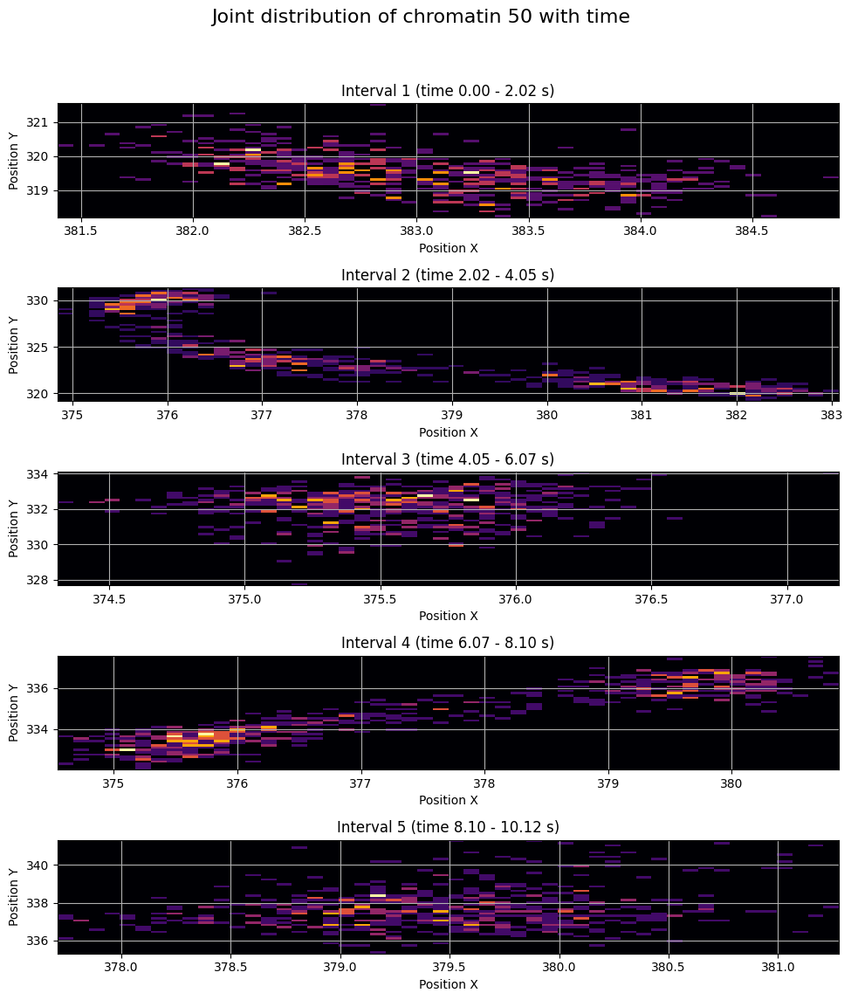

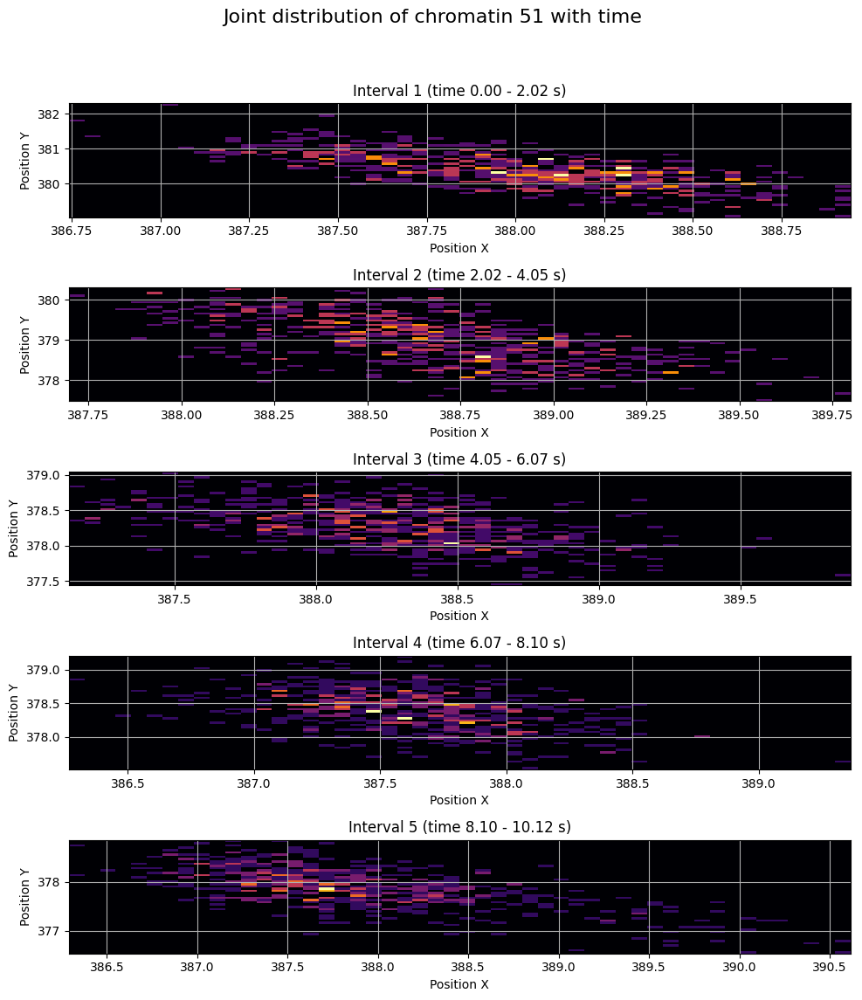

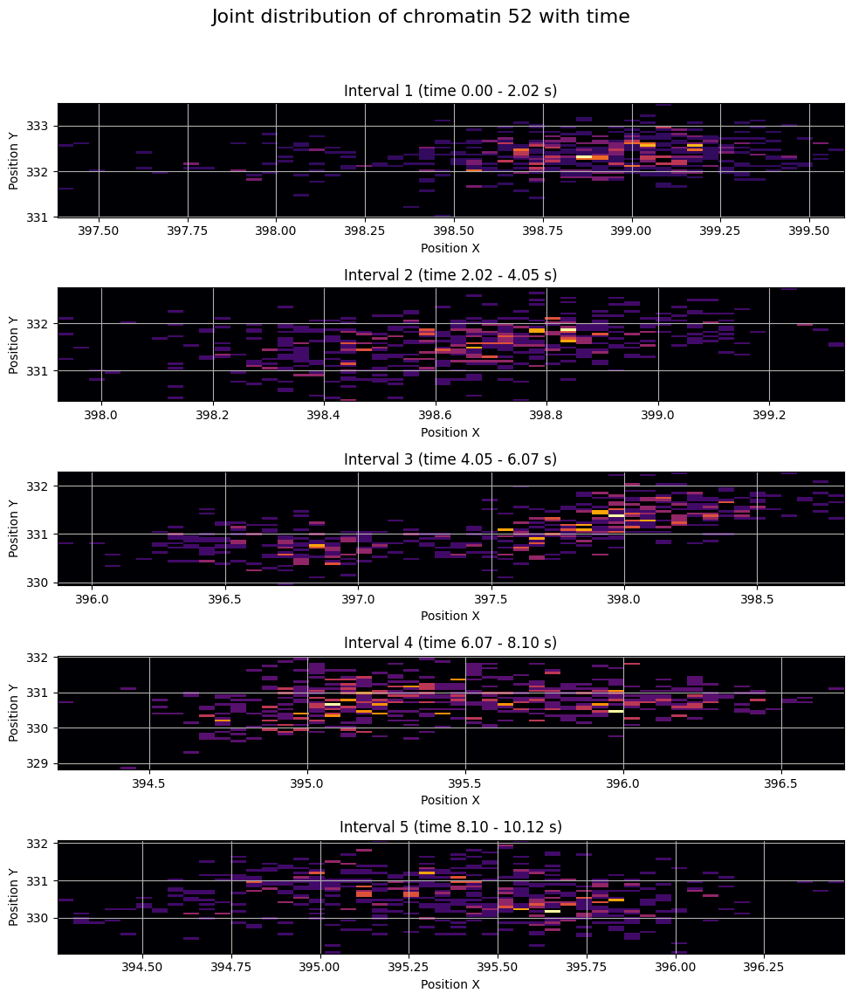

In [6]:
# ESTE ENFOQUE DEL CODIGO LE GUSTÓ BASTANTE, MANTENER

num_intervals = 5  #intervalos de tiempo
interval_length = n_puntos // num_intervals  # Longitud de cada intervalo


for cromatin_index in range(n_trayectorias):
    trajectory_x = trajectories[cromatin_index, :, 0]
    trajectory_y = trajectories[cromatin_index, :, 1]

    fig, axes = plt.subplots(num_intervals, 1, figsize=(10, 12))
    plt.suptitle(f'Joint distribution of chromatin {cromatin_index + 1} with time', fontsize=16)
    
    for i in range(num_intervals):
        # intervalo de tiempo
        start_idx = i * interval_length
        end_idx = (i + 1) * interval_length if (i + 1) * interval_length < n_puntos else n_puntos
        #x e y en este intervalo
        x_interval = trajectory_x[start_idx:end_idx]
        y_interval = trajectory_y[start_idx:end_idx]
        axes[i].hist2d(x_interval, y_interval, bins=50, density=True, cmap='inferno')
        axes[i].set_title(f'Interval {i+1} (time {start_idx*dt:.2f} - {end_idx*dt:.2f} s)')
        axes[i].set_xlabel('Position X')
        axes[i].set_ylabel('Position Y')
        axes[i].grid(True)
    
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()


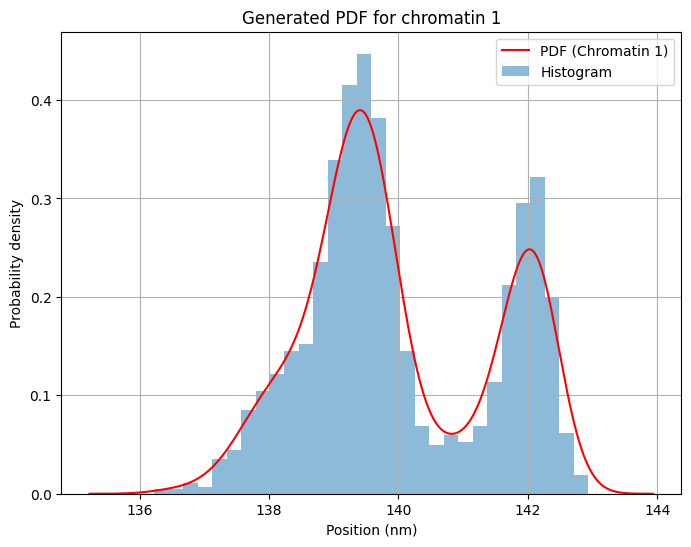

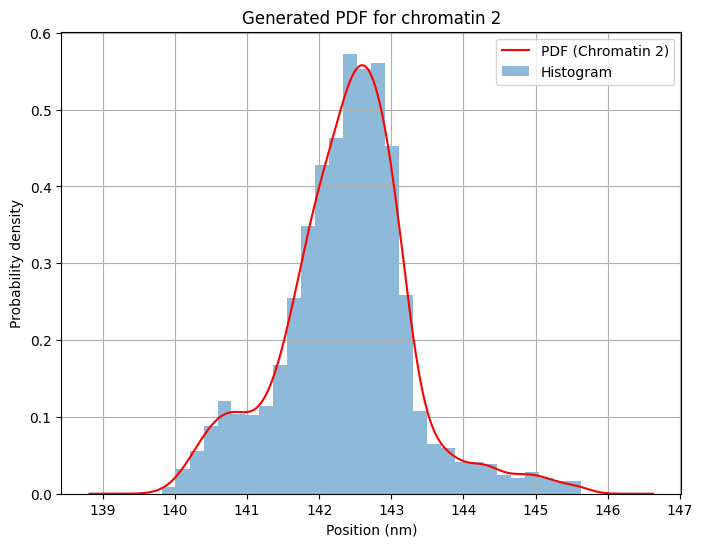

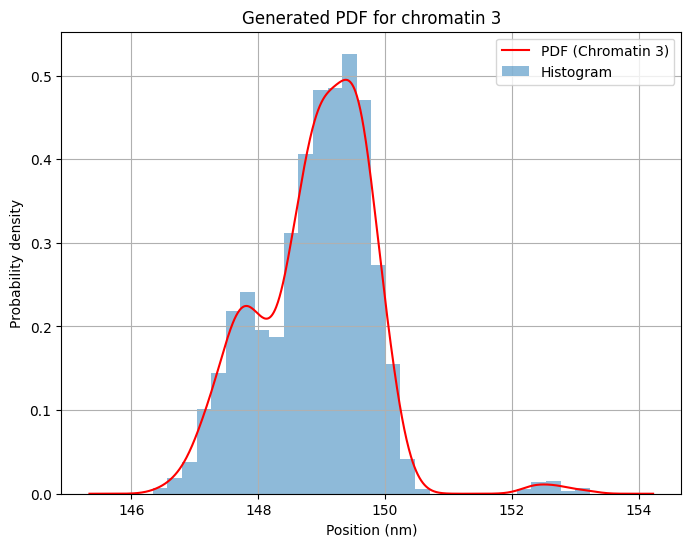

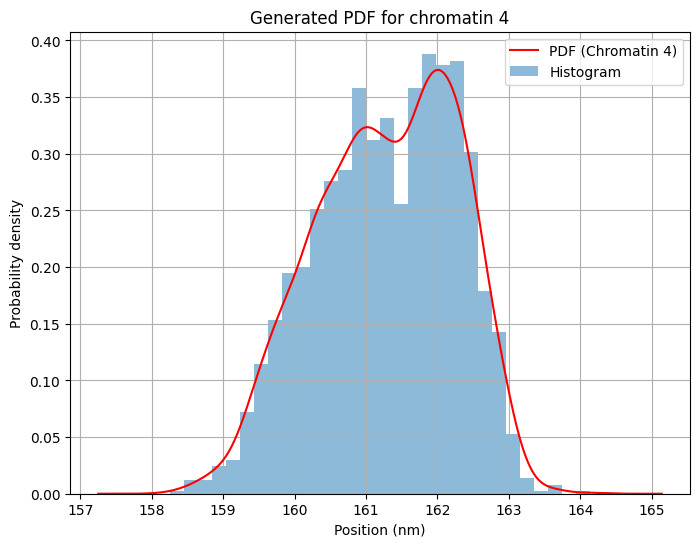

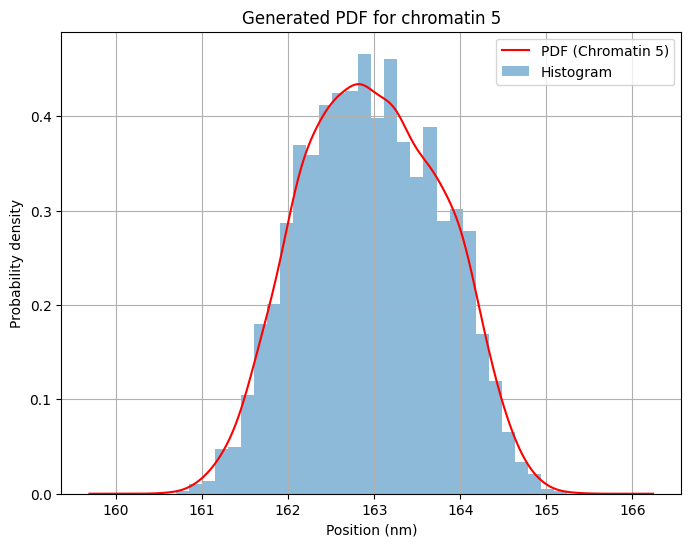

...

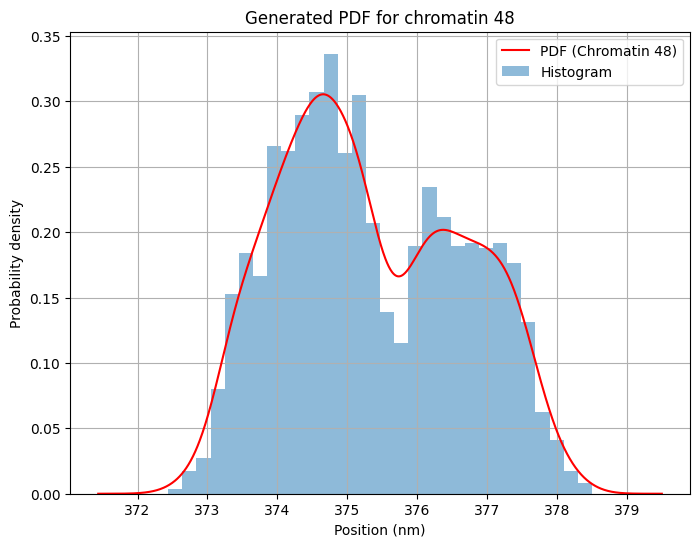

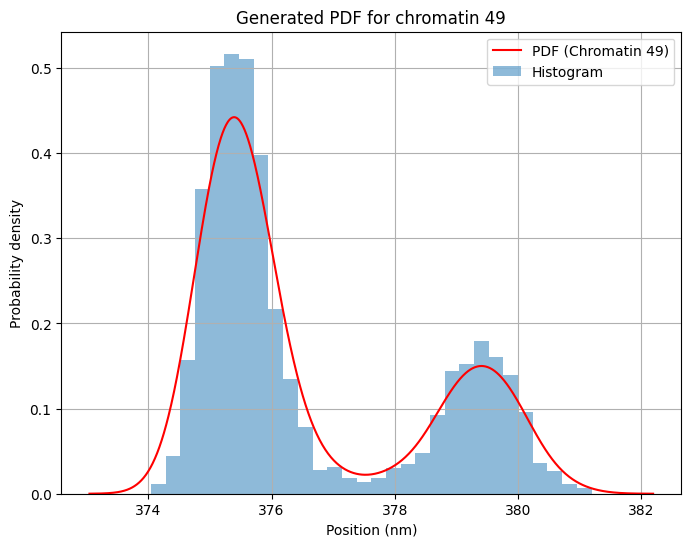

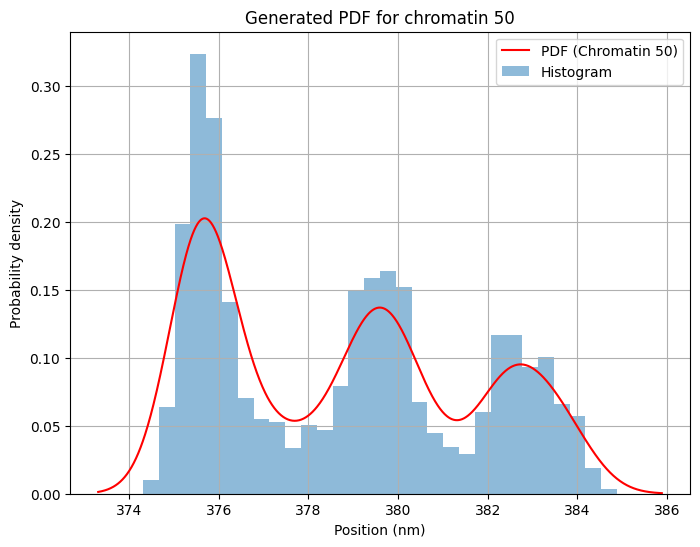

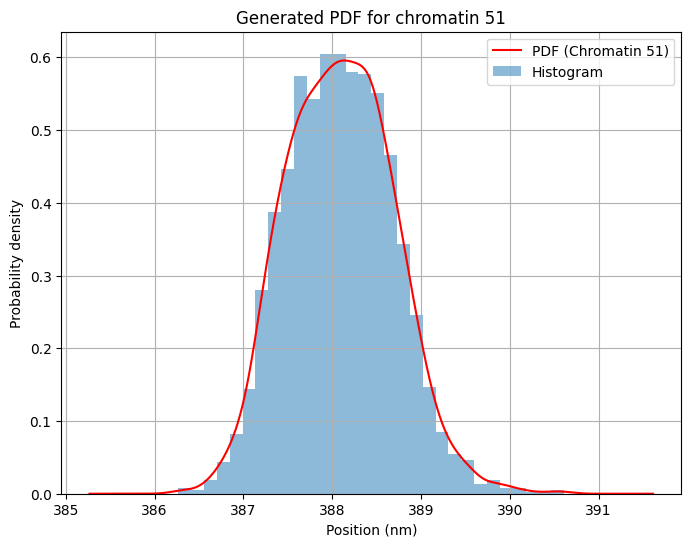

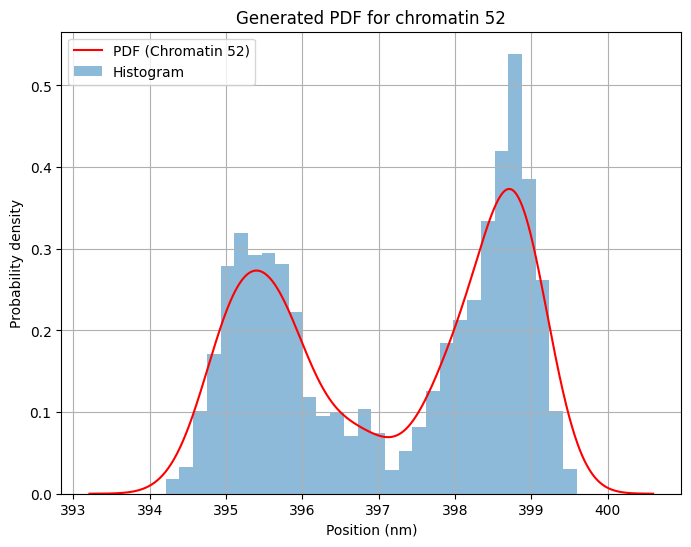

In [7]:
for i in range(n_trayectorias):
    trajectory_x = trajectories[i, :, 0]  
    kde = gaussian_kde(trajectory_x)
    x_range = np.linspace(min(trajectory_x) - 1, max(trajectory_x) + 1, 1000)
    pdf_values = kde(x_range)

    plt.figure(figsize=(8, 6))
    plt.plot(x_range, pdf_values, label=f"PDF (Chromatin {i+1})", color="red")
    plt.hist(trajectory_x, bins=30, density=True, alpha=0.5, label="Histogram")
    plt.title(f"Generated PDF for chromatin {i+1}")
    plt.xlabel("Position (nm)")
    plt.ylabel("Probability density")
    plt.legend()
    plt.grid(True)
    plt.show()
    


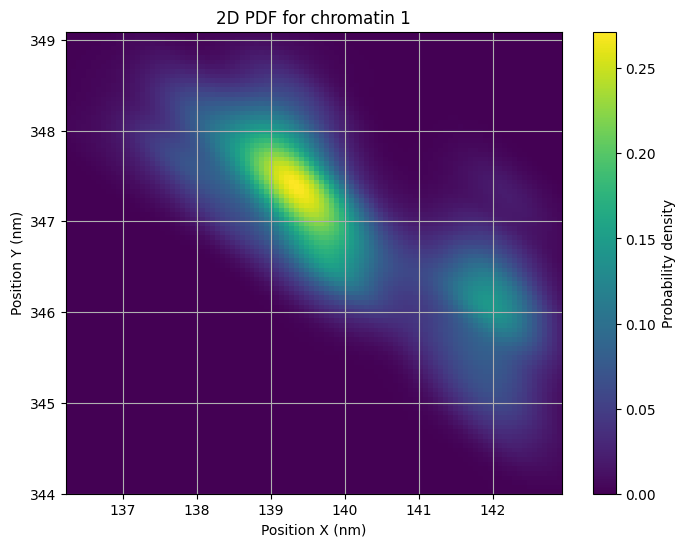

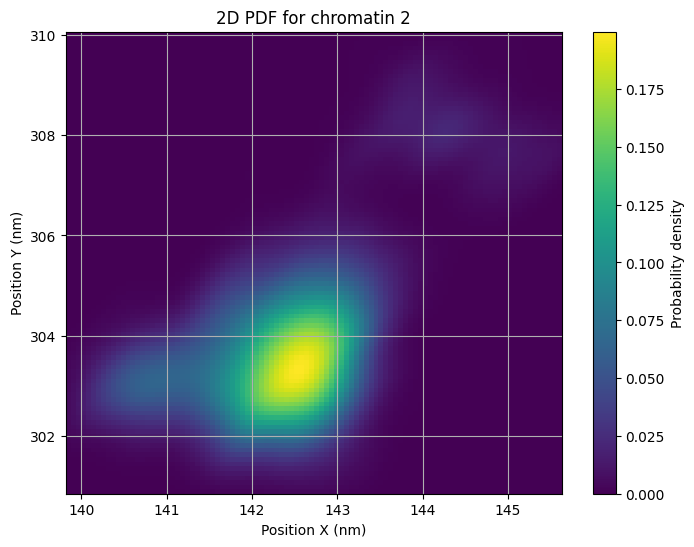

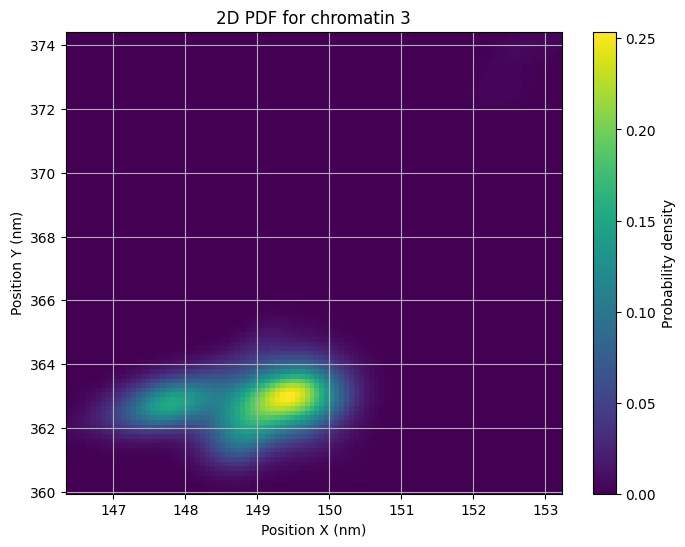

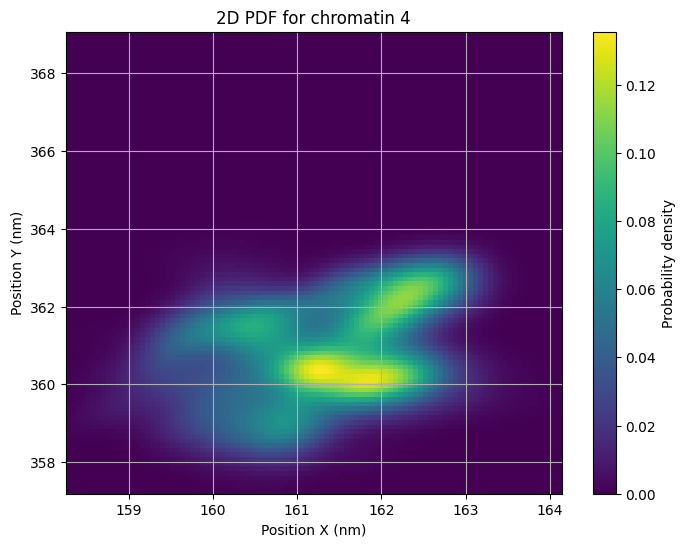

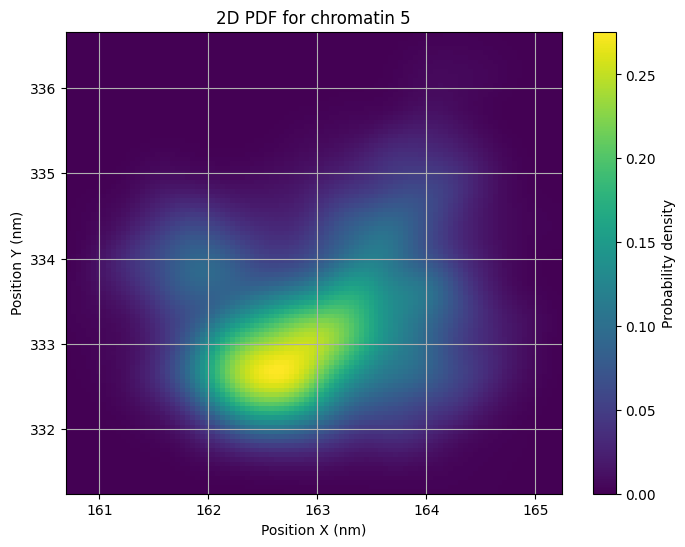

...

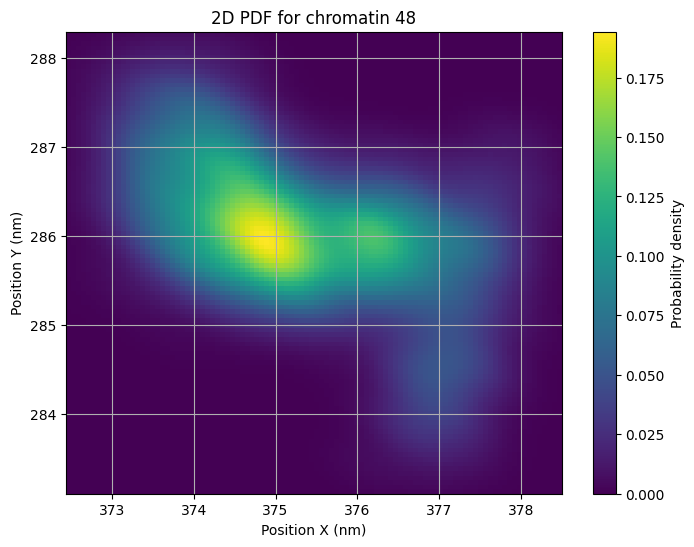

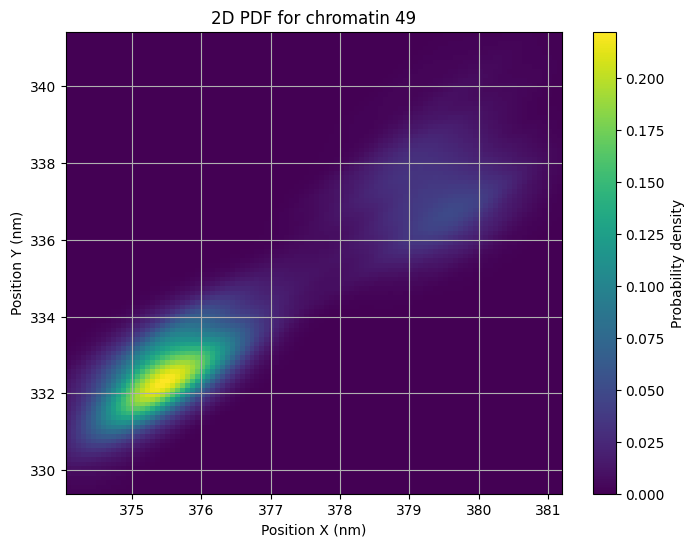

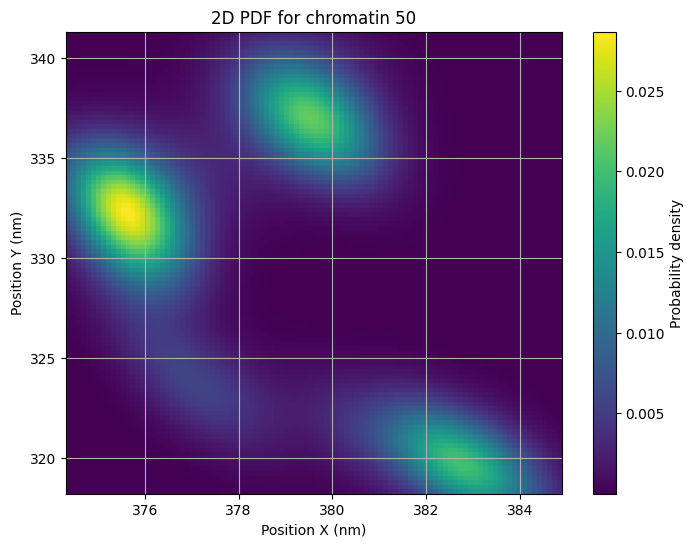

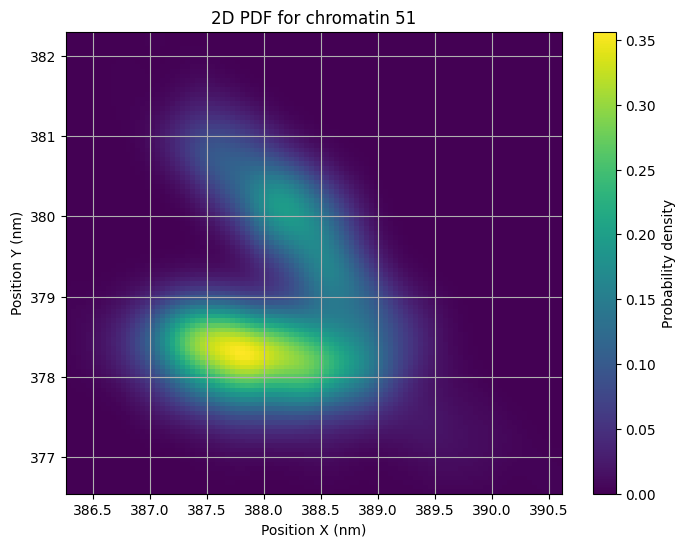

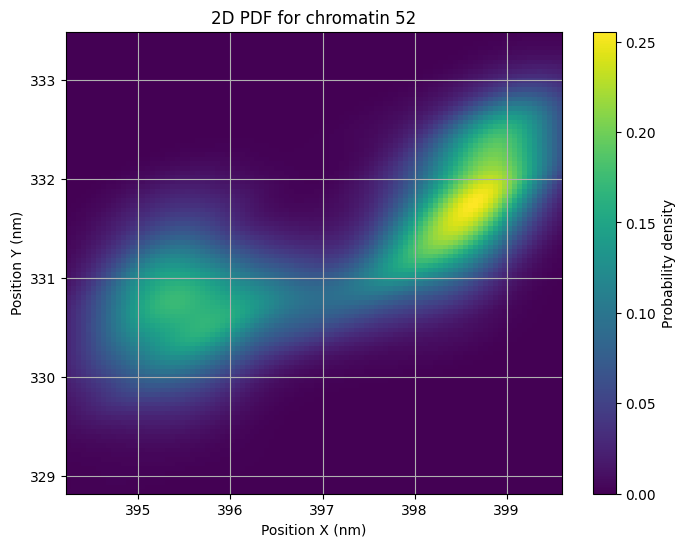

In [8]:
# Recorrer cada cromatina y calcular su KDE 2D
for i in range(n_trayectorias):
    trajectory_x = trajectories[i, :, 0]  # x
    trajectory_y = trajectories[i, :, 1]  #y

    # combino x y en matriz 2d para kde
    data_2d = np.vstack([trajectory_x, trajectory_y])
    kde_2d = gaussian_kde(data_2d)  # KDE 2D

    # rango para densidad
    x_range = np.linspace(min(trajectory_x), max(trajectory_x), 100)
    y_range = np.linspace(min(trajectory_y), max(trajectory_y), 100)
    X, Y = np.meshgrid(x_range, y_range)
    positions = np.vstack([X.ravel(), Y.ravel()]) #organiza puntos en vectores de X e Y para ser evaluados por kde
    pdf_values_2d = kde_2d(positions).reshape(X.shape)

    
    plt.figure(figsize=(8, 6))
    plt.imshow(pdf_values_2d, origin="lower", extent=[min(x_range), max(x_range), min(y_range), max(y_range)],
               aspect="auto", cmap="viridis")
    plt.colorbar(label="Probability density")
    plt.title(f"2D PDF for chromatin {i+1}")
    plt.xlabel("Position X (nm)")
    plt.ylabel("Position Y (nm)")
    plt.grid(True)
    plt.show()

In [9]:
x_first = trajectory_x_first  
v_first = velocidad_x_first 
dt = 1/250  
y_first = trajectories[0, :, 1]

Parámetros ajustados con Elastic Net:
Alpha (coeficiente cuadrático): 1.6
Beta (coeficiente cúbico): 4.9e-05
Gamma (coeficiente de amortiguamiento): 1.3
Modelo de doble pozo ajustado: ddx/dt^2 = -(1.3) * dx/dt - (2 * 1.6 * x + 4 * 4.9e-05 * x^3)


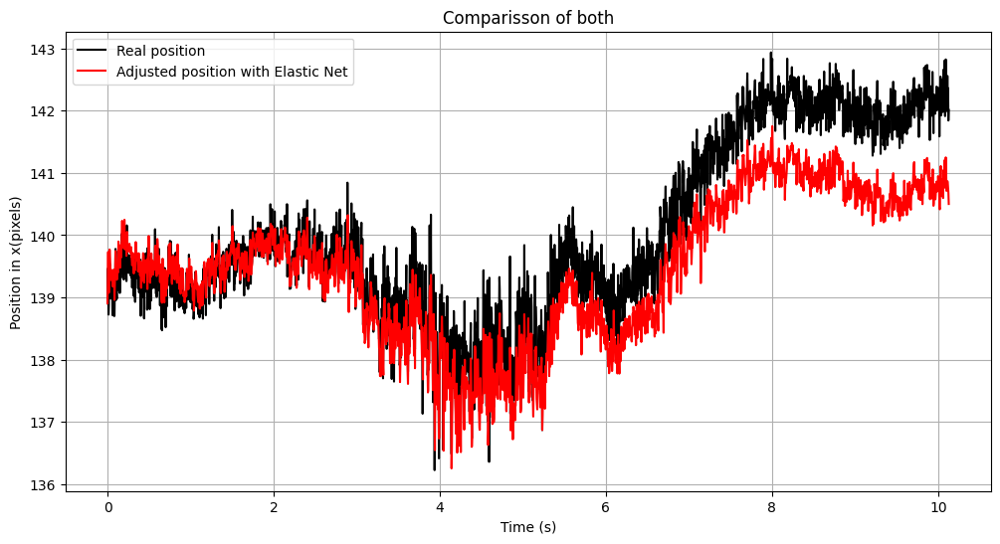

In [10]:
#AQUI USO ELASTIC NET
#INTENTAR APLICAR AQUI ELASTIC NET PARA QUE NO ME DEN VALORES TAN PEQUEÑOS
def modelo_langevin(params, x, v, dt, k_B, T):
    alpha, beta, gamma = params  
    
    F_x = -2 * alpha * x + 4 * beta * x**3  #(3)
    a_pred = -gamma * v - F_x #(1.1)
    
    noise_strength = np.sqrt(2 * gamma * k_B * T) #esto seria mi sigma
    noise_strength = np.maximum(noise_strength, 0)  # Evitar valores negativos o cero

    #añado ruido blanco
    ruido = noise_strength * np.random.normal(size=len(x))
    a_pred += ruido
    
    return a_pred

def loss_with_elastic_net(params, x, v, dt, k_B, T, l1_ratio, alpha_penalty):
    a_real = np.gradient(v, dt)  
    a_pred = modelo_langevin(params, x, v, dt, k_B, T)
    
    mse_loss = mean_squared_error(a_real, a_pred)
    elastic_net_penalty = alpha_penalty * (
        l1_ratio * np.sum(np.abs(params)) + (1 - l1_ratio) * np.sum(params**2)
    )
    
    return mse_loss + elastic_net_penalty

# hiperparámetros de Elastic Net
l1_ratio = 0.5  # l1 y l2, entonces 0.5 para balancear ambos
alpha_penalty = 1 # Escala de la penalización
initial_guess = [1, 1, 1]  # Valores iniciales para los param

elastic_net_result = minimize(
    loss_with_elastic_net, 
    initial_guess, 
    args=(x_first, v_first, dt, k_B, T, l1_ratio, alpha_penalty),
    method='Nelder-Mead'
)

#params ajustados con elastic net
alpha_opt, beta_opt, gamma_opt = elastic_net_result.x

print(f"Parámetros ajustados con Elastic Net:\nAlpha (coeficiente cuadrático): {alpha_opt:.2g}\nBeta (coeficiente cúbico): {beta_opt:.2g}\nGamma (coeficiente de amortiguamiento): {gamma_opt:.2g}")
print(f"Modelo de doble pozo ajustado: ddx/dt^2 = -({gamma_opt:.2g}) * dx/dt - (2 * {alpha_opt:.2g} * x + 4 * {beta_opt:.2g} * x^3)")

#generar las predicciones de la misma forma
x_pred = [x_first[0]]  #posición inicial

for i in range(1, len(x_first)): #de la segunda posicion en adelante
    F_x = -2 * alpha_opt * x_pred[-1] + 4 * beta_opt * x_pred[-1]**3 
    a_pred = -gamma_opt * v_first[i-1] - F_x 

    ruido = np.sqrt(2 * gamma_opt * k_B * T) * np.random.normal()
    a_pred += ruido  #ruido en la aceleración
    x_new = x_pred[-1] + v_first[i-1] * dt + 0.5 * a_pred * dt**2  # Movimiento con euler
    x_pred.append(x_new)


plt.figure(figsize=(12, 6))
plt.plot(t_first, x_first, label="Real position ", color='black')
plt.plot(t_first, x_pred, label="Adjusted position with Elastic Net", color='red')
plt.title('Comparisson of both')
plt.xlabel('Time (s)')
plt.ylabel('Position in x(pixels)')
plt.legend()
plt.grid(True)
plt.show()



In [11]:
# Definir la función de ajuste para el MSD
def ajuste_msd(t, K, alpha):
    """Función de ajuste: MSD = K * t^alpha."""
    return K * t**alpha


In [12]:
def calcular_msd_individual(trayectoria, dt=1/250):
    n_puntos = len(trayectoria)
    max_tiempo = n_puntos - 1 #num max de retardos temporales
    msd = np.zeros(max_tiempo)
    
    for t in range(1, max_tiempo + 1):
        desplazamientos = trayectoria[t:] - trayectoria[:-t]
        desplazamientos_cuadrados = desplazamientos**2
        msd[t-1] = np.mean(desplazamientos_cuadrados)
    
    tiempos = np.arange(1, max_tiempo + 1) * dt # arreglo de tiempos multiplicando cada intervalo temporal por el intervalo de muestreo
    return tiempos, msd

#MSD(t)=⟨[x(t+t 0 )−x(t0)]2 ⟩ formula implementada


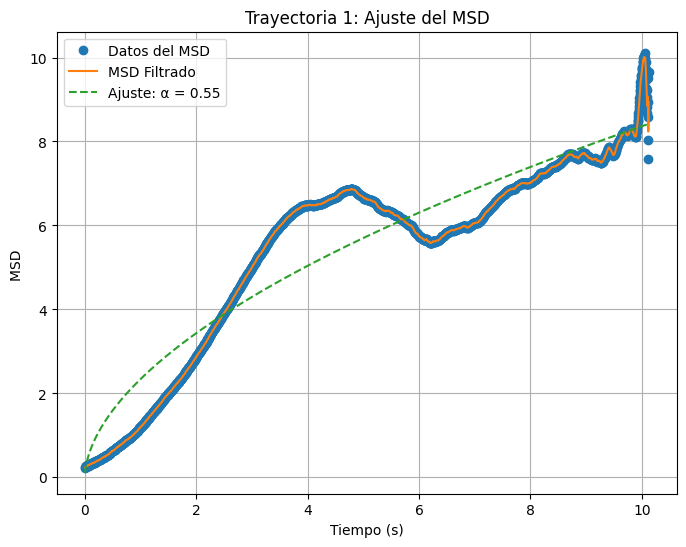

Trayectoria 1: Subdifusivo (α = 0.55)


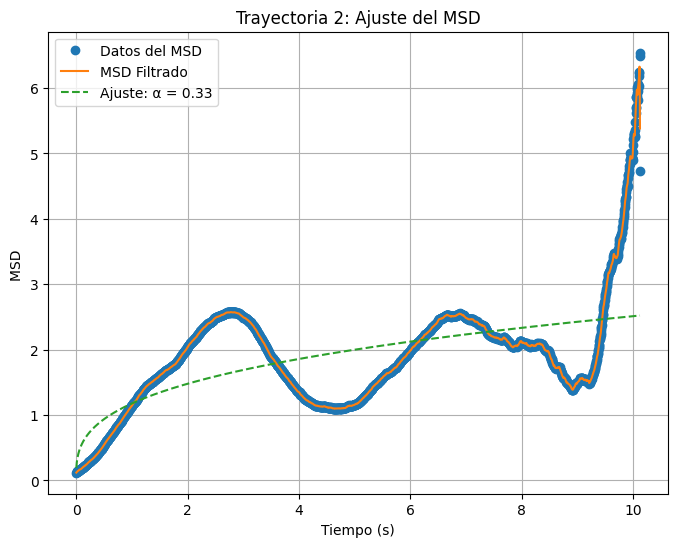

Trayectoria 2: Subdifusivo (α = 0.33)


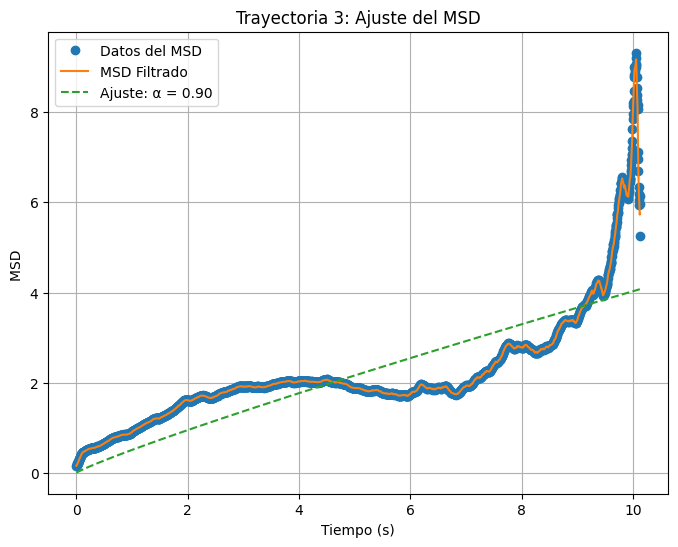

Trayectoria 3: Subdifusivo (α = 0.90)


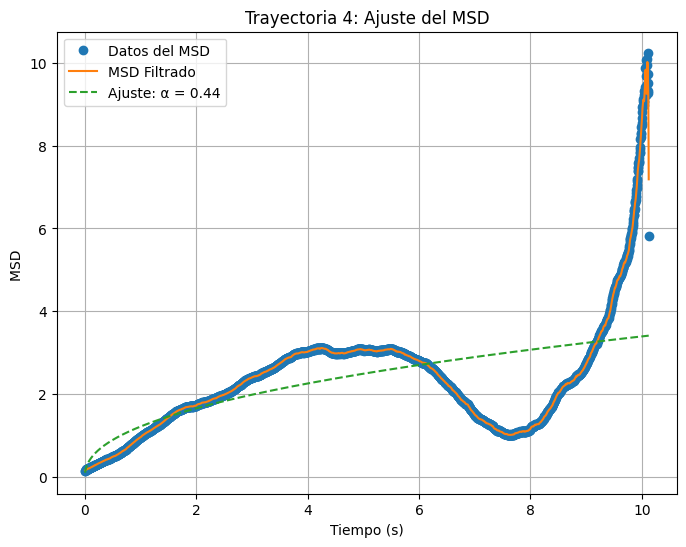

Trayectoria 4: Subdifusivo (α = 0.44)


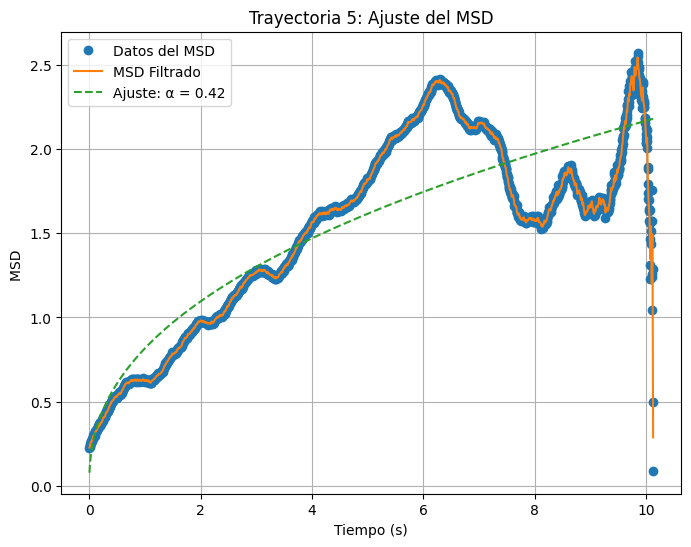

Trayectoria 5: Subdifusivo (α = 0.42)


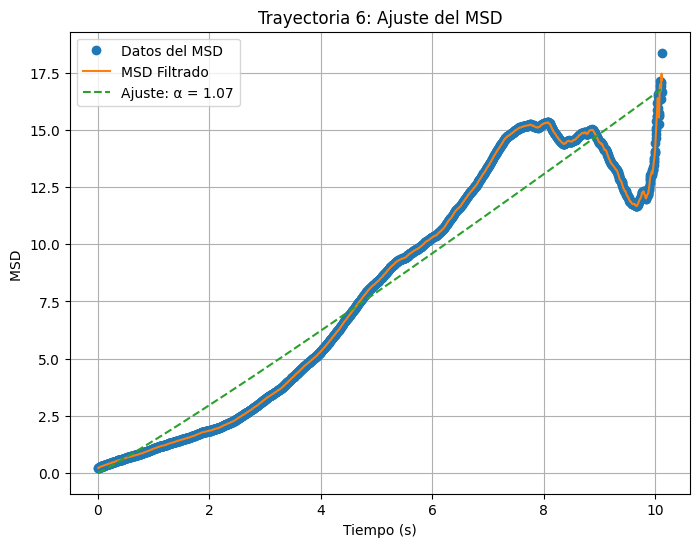

Trayectoria 6: Difusivo normal (α = 1.07)


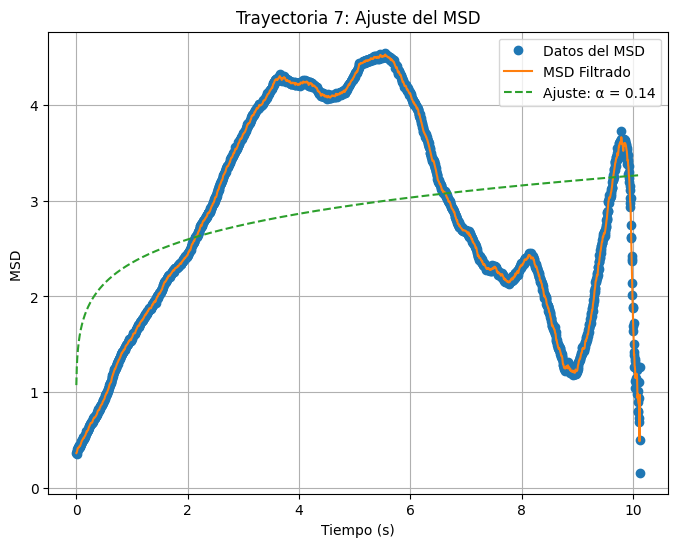

Trayectoria 7: Subdifusivo (α = 0.14)


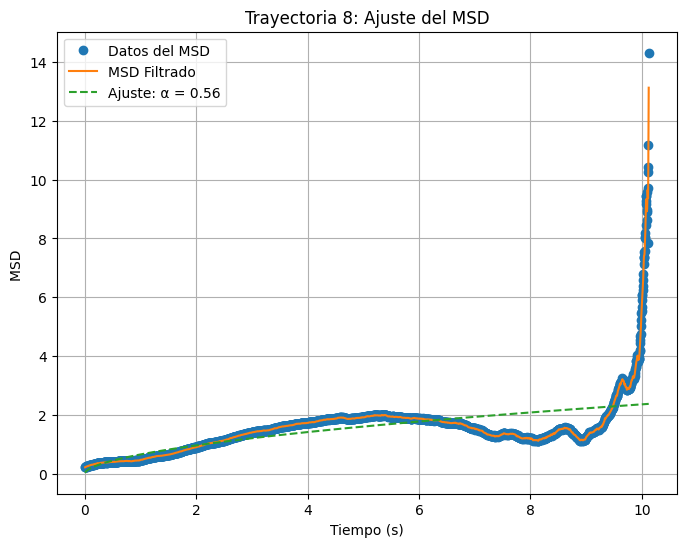

Trayectoria 8: Subdifusivo (α = 0.56)


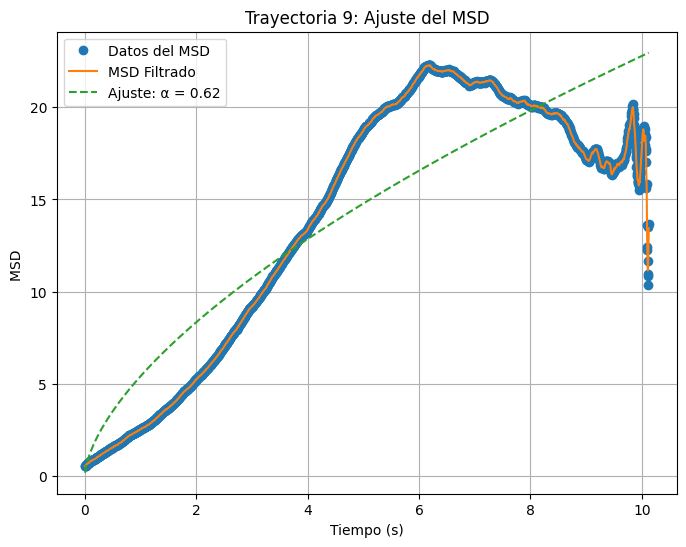

Trayectoria 9: Subdifusivo (α = 0.62)


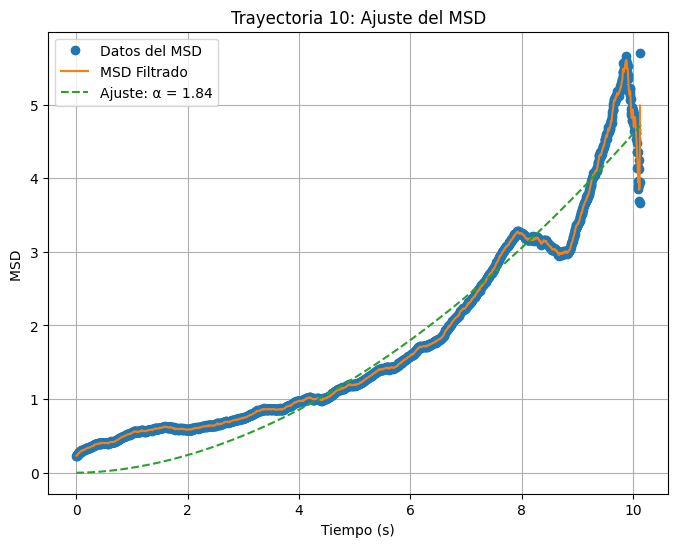

Trayectoria 10: Superdifusivo (α = 1.84)


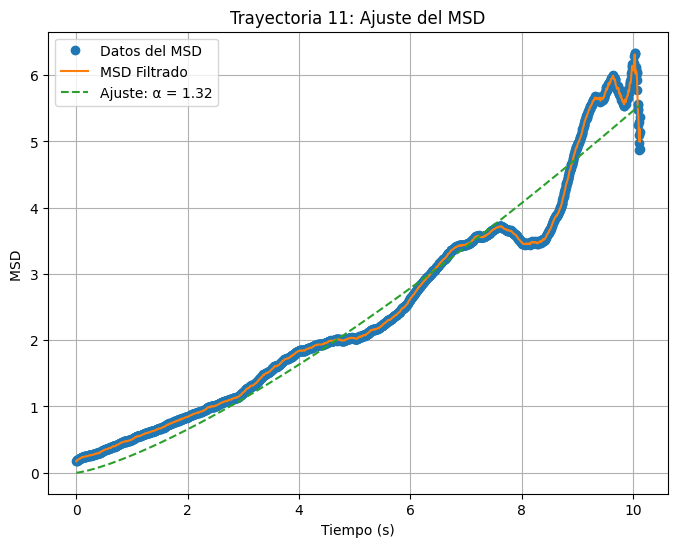

Trayectoria 11: Superdifusivo (α = 1.32)


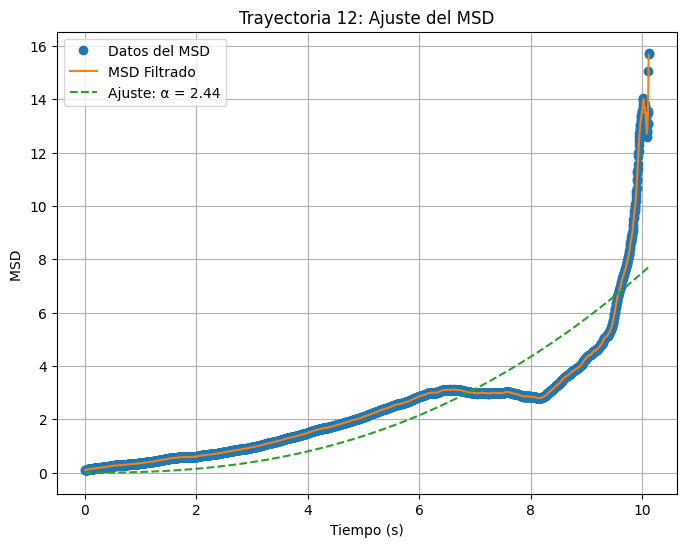

Trayectoria 12: Superdifusivo (α = 2.44)


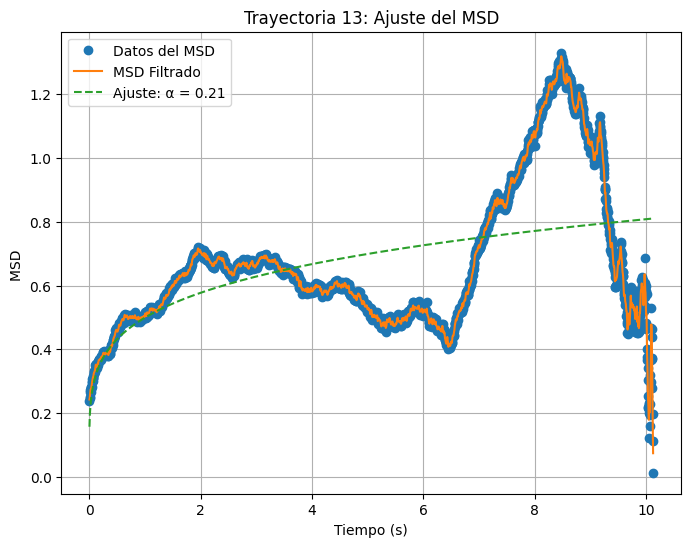

Trayectoria 13: Subdifusivo (α = 0.21)


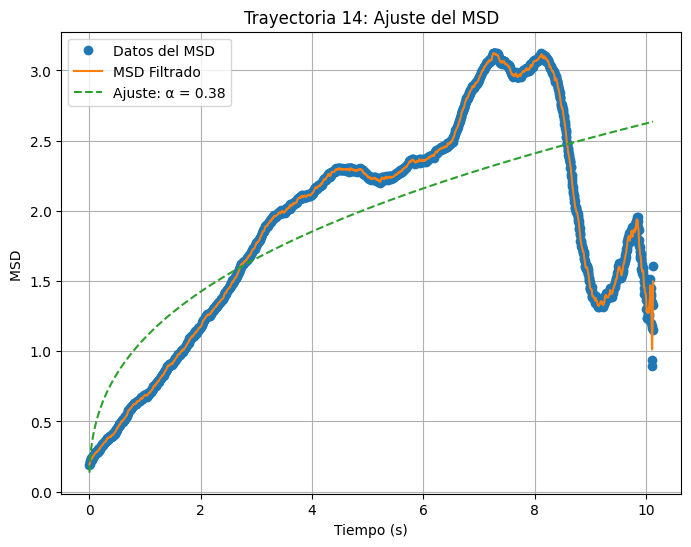

Trayectoria 14: Subdifusivo (α = 0.38)


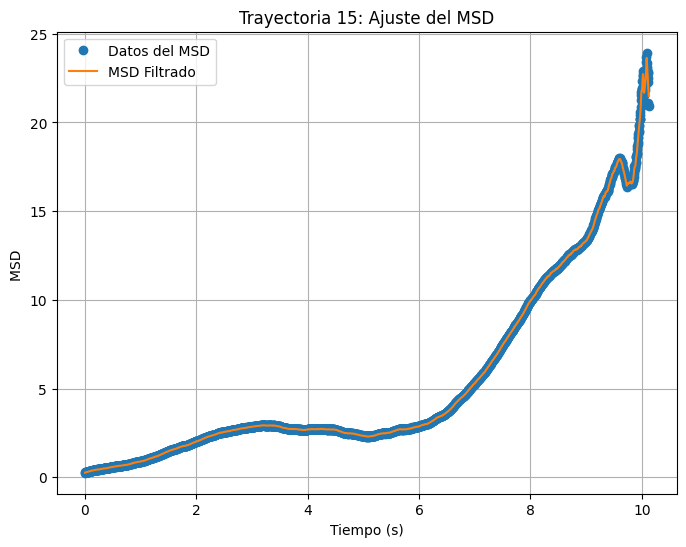

Trayectoria 15: Indeterminado (α = nan)


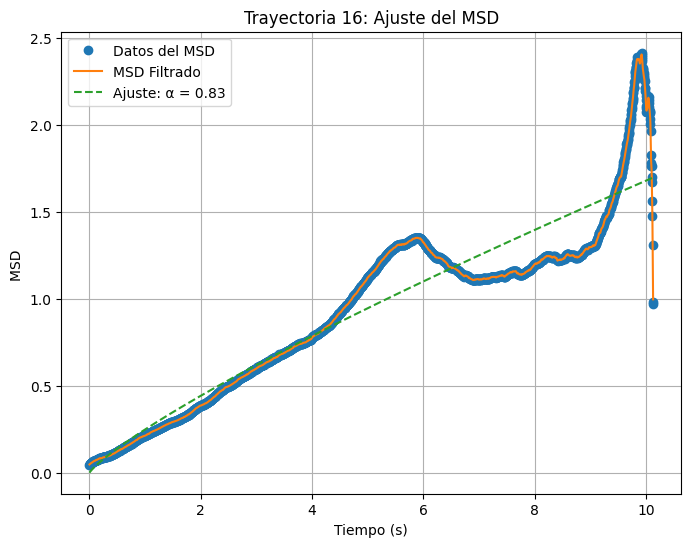

Trayectoria 16: Subdifusivo (α = 0.83)


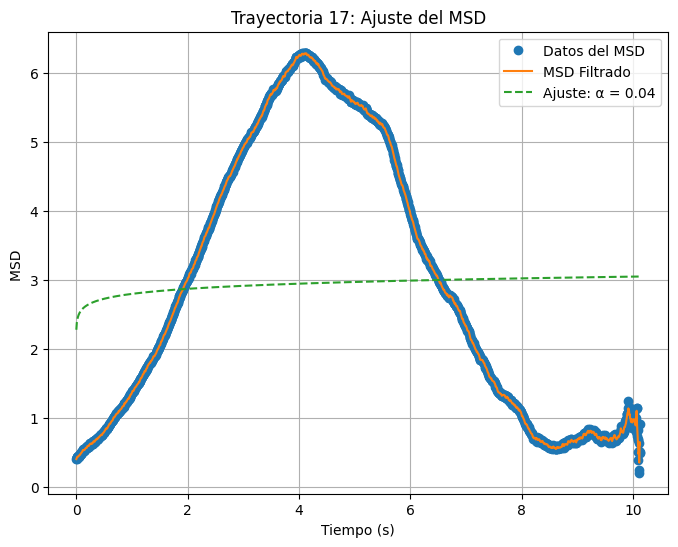

Trayectoria 17: Subdifusivo (α = 0.04)


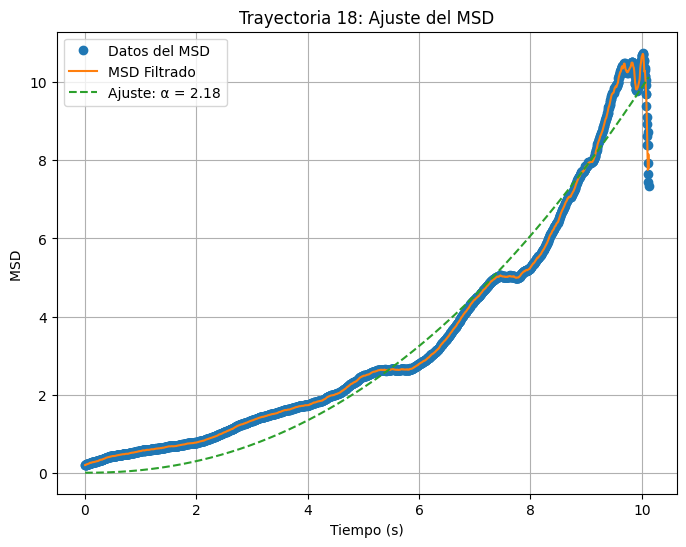

Trayectoria 18: Superdifusivo (α = 2.18)


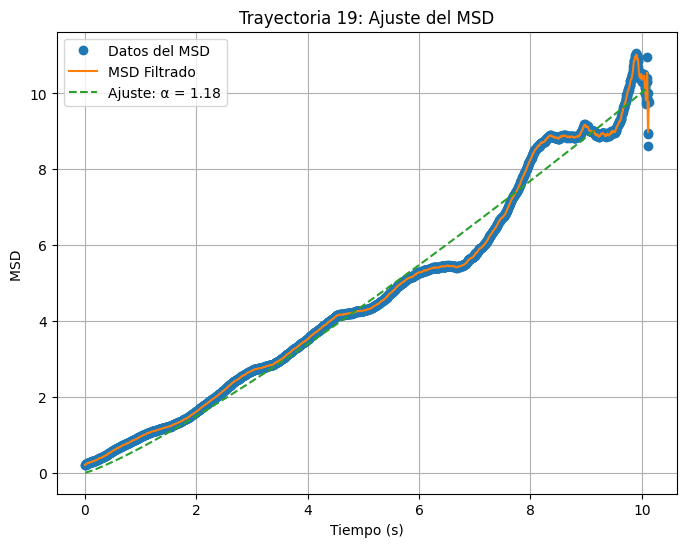

Trayectoria 19: Superdifusivo (α = 1.18)


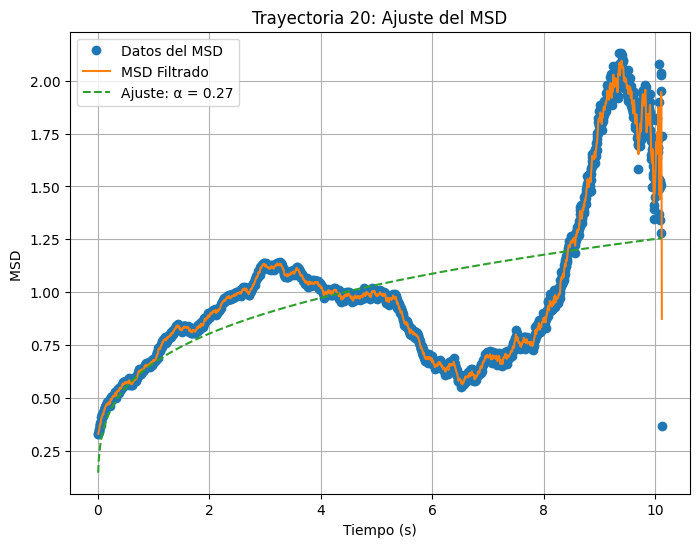

Trayectoria 20: Subdifusivo (α = 0.27)


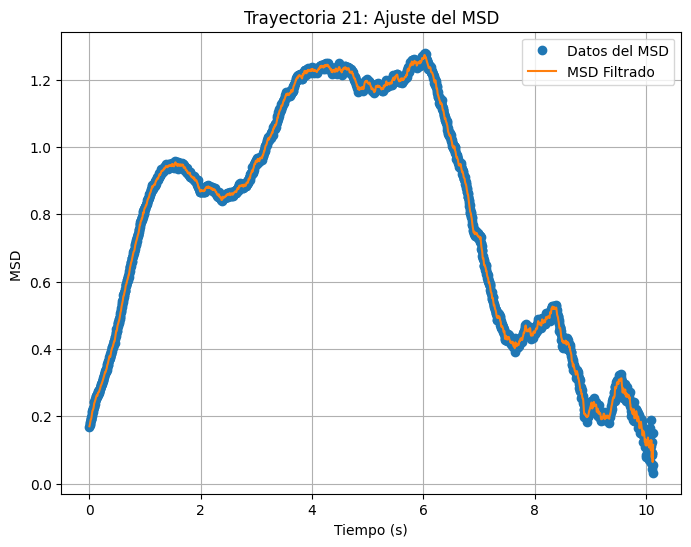

Trayectoria 21: Indeterminado (α = nan)


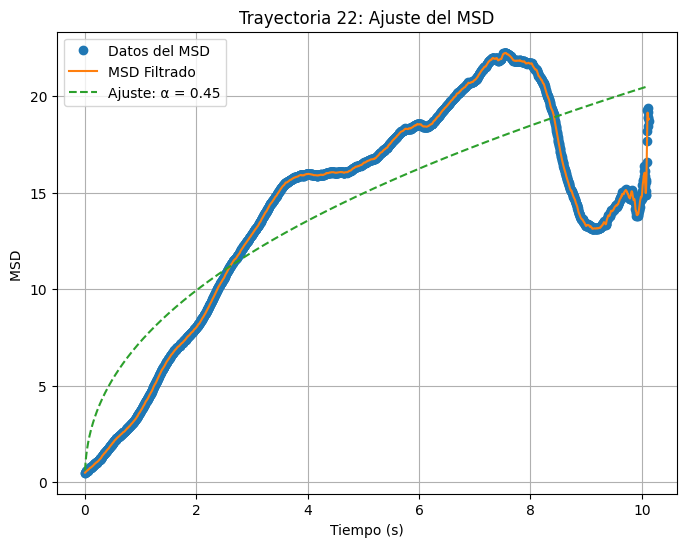

Trayectoria 22: Subdifusivo (α = 0.45)


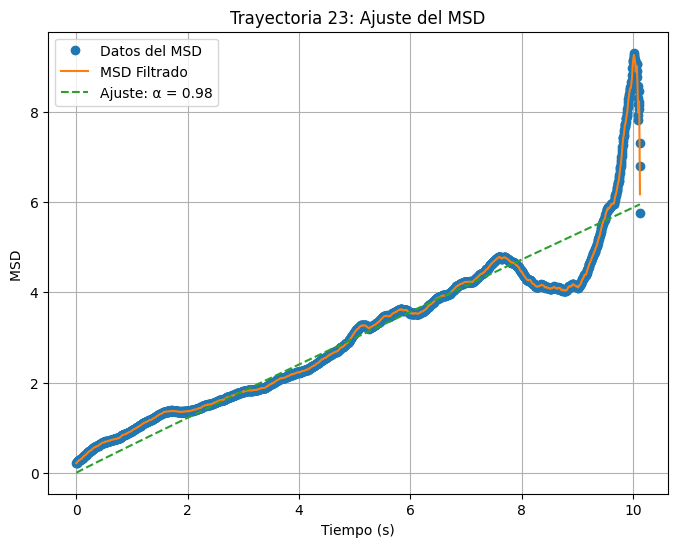

Trayectoria 23: Subdifusivo (α = 0.98)


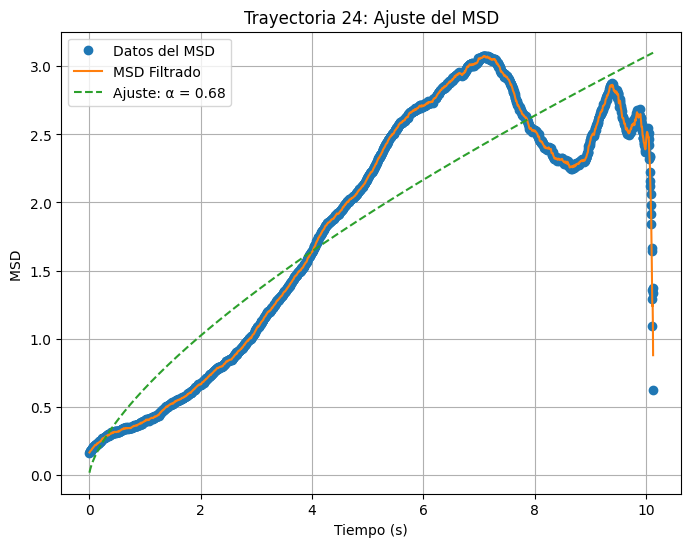

Trayectoria 24: Subdifusivo (α = 0.68)


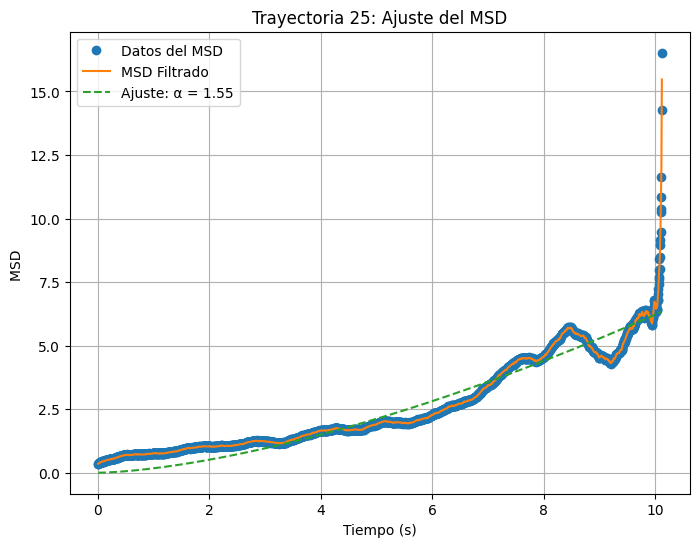

Trayectoria 25: Superdifusivo (α = 1.55)


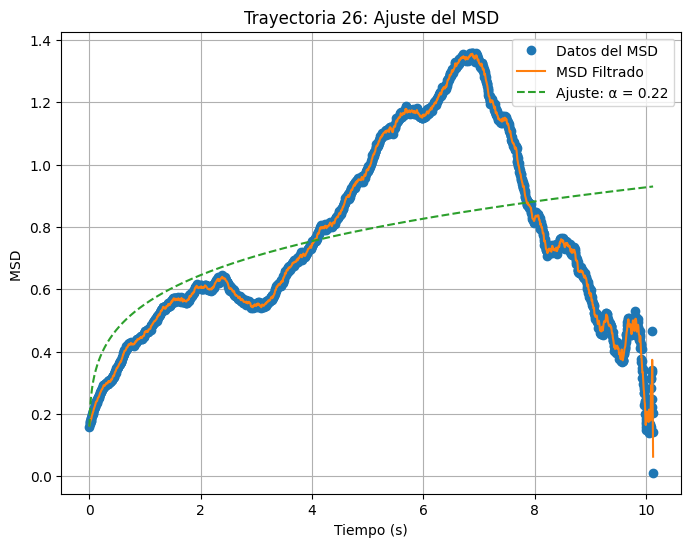

Trayectoria 26: Subdifusivo (α = 0.22)


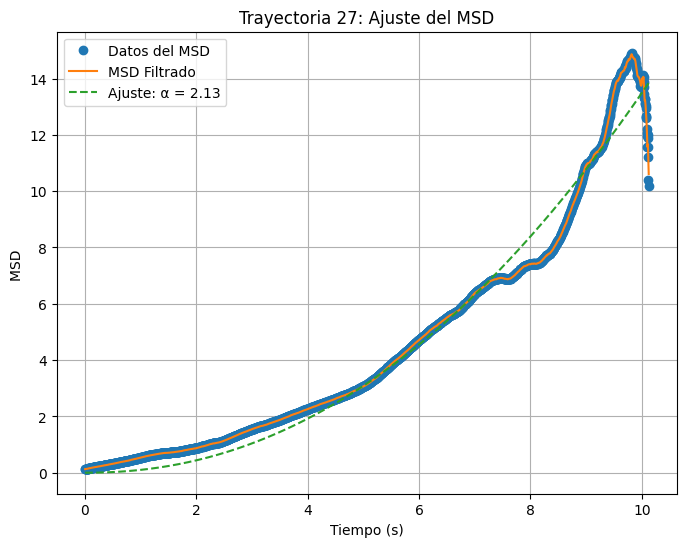

Trayectoria 27: Superdifusivo (α = 2.13)


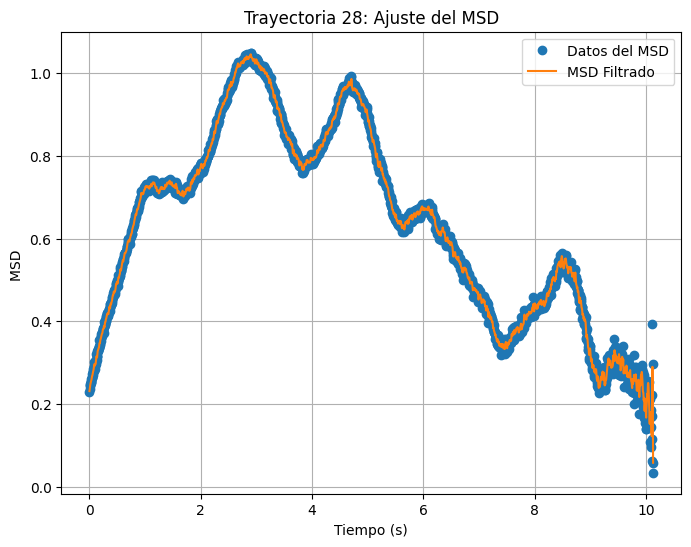

Trayectoria 28: Indeterminado (α = nan)


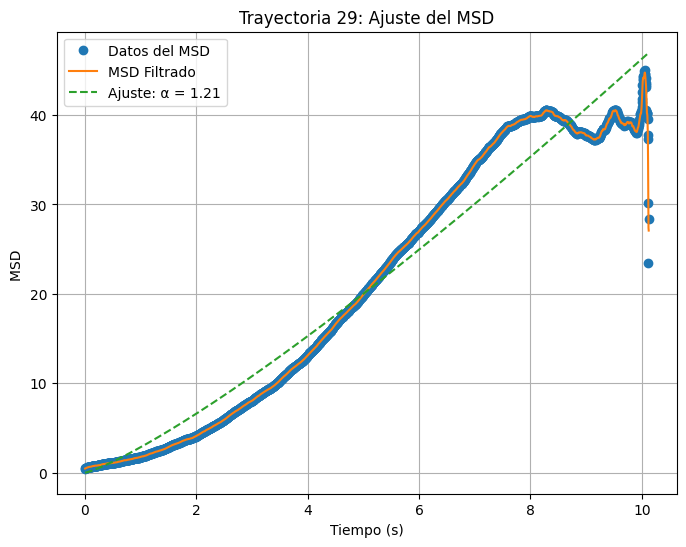

Trayectoria 29: Superdifusivo (α = 1.21)


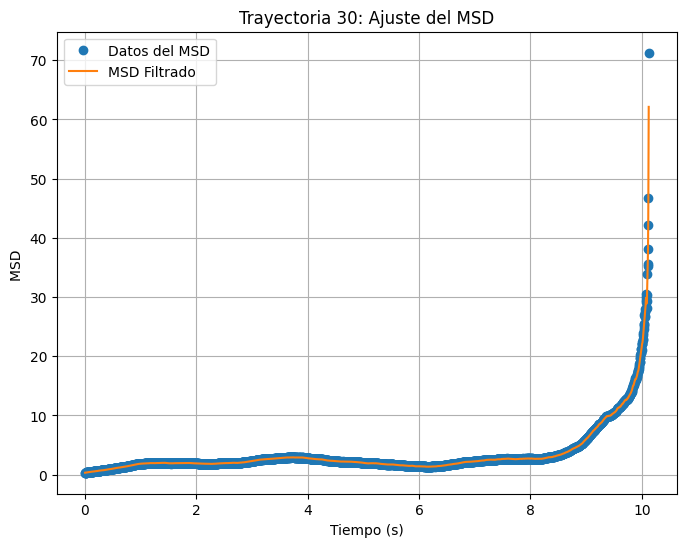

Trayectoria 30: Indeterminado (α = nan)


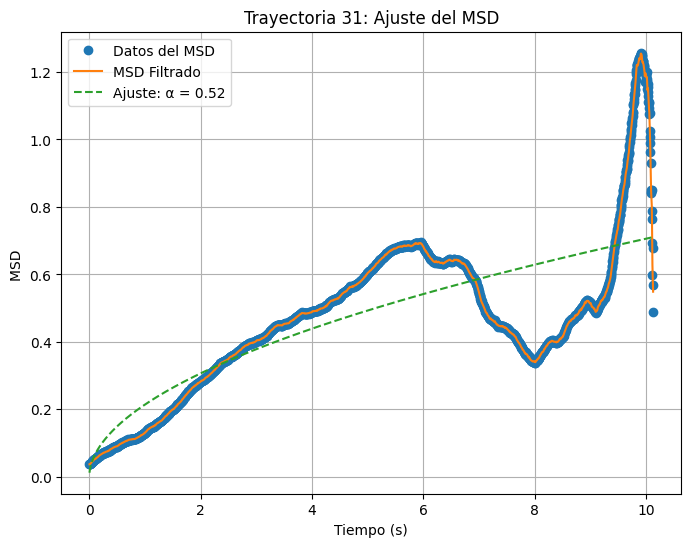

Trayectoria 31: Subdifusivo (α = 0.52)


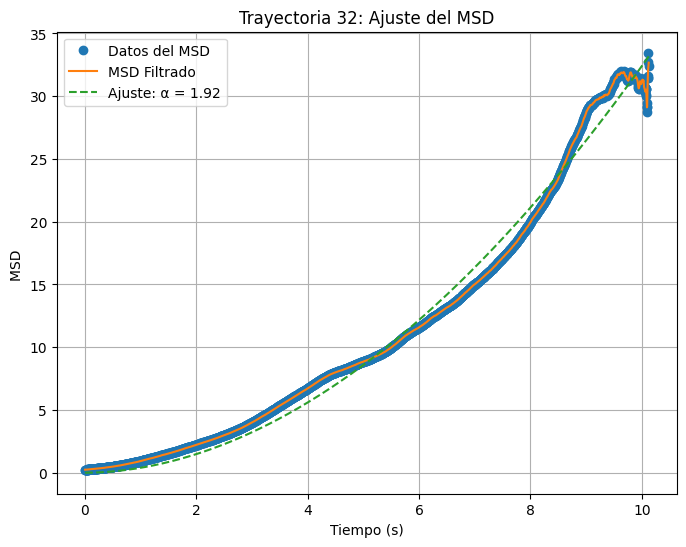

Trayectoria 32: Superdifusivo (α = 1.92)


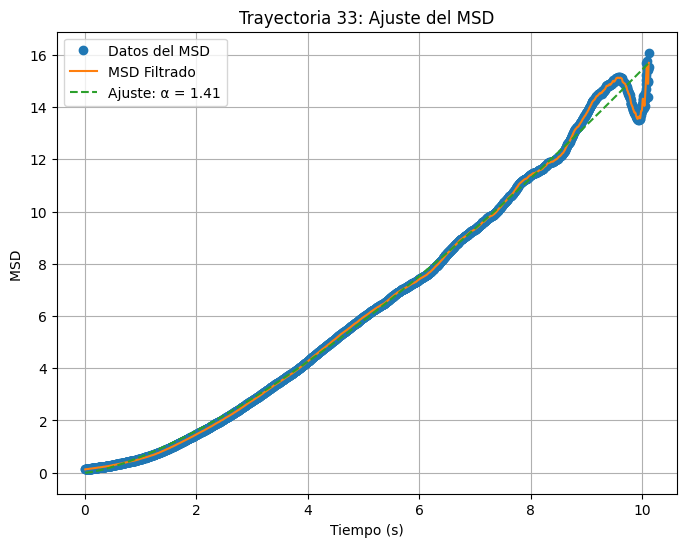

Trayectoria 33: Superdifusivo (α = 1.41)


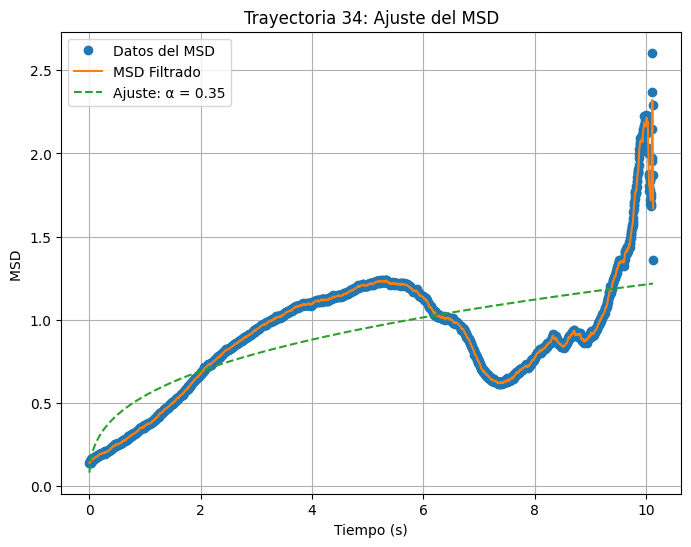

Trayectoria 34: Subdifusivo (α = 0.35)


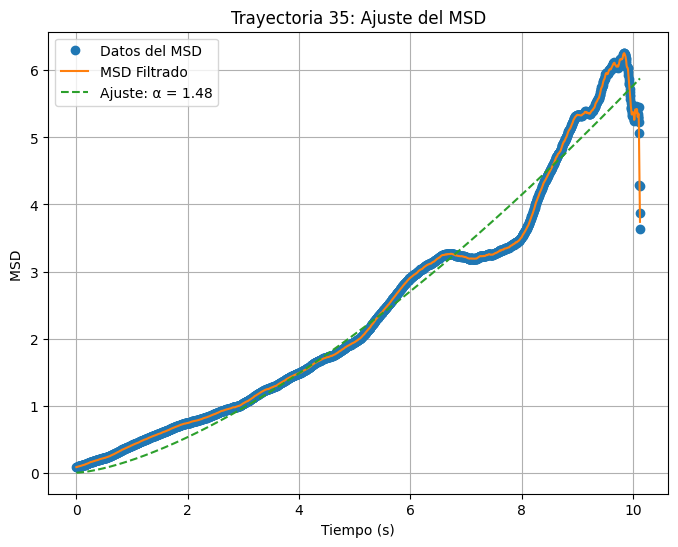

Trayectoria 35: Superdifusivo (α = 1.48)


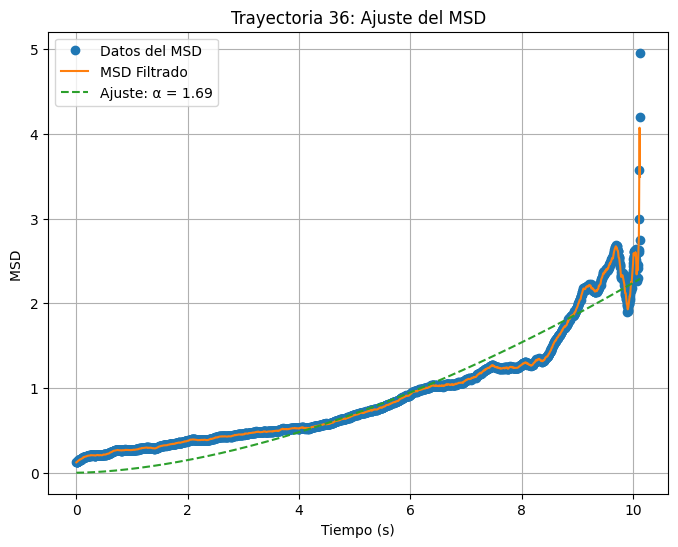

Trayectoria 36: Superdifusivo (α = 1.69)


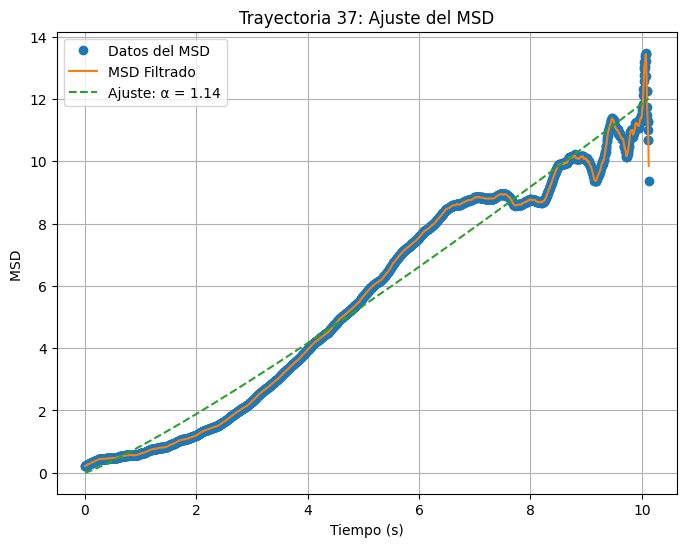

Trayectoria 37: Superdifusivo (α = 1.14)


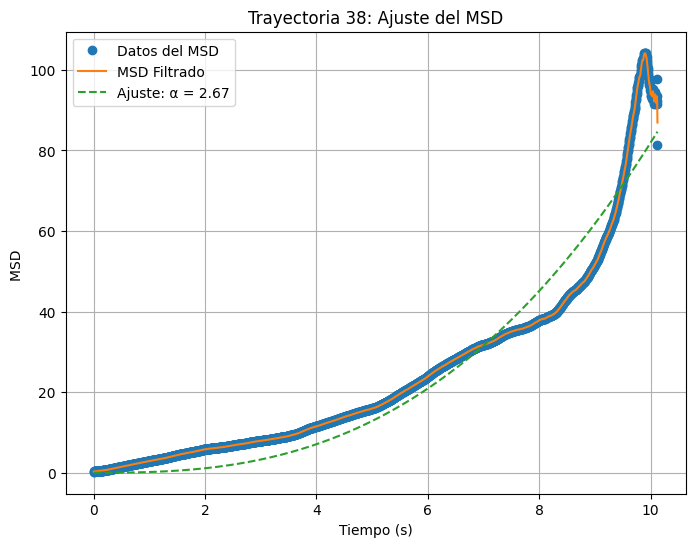

Trayectoria 38: Superdifusivo (α = 2.67)


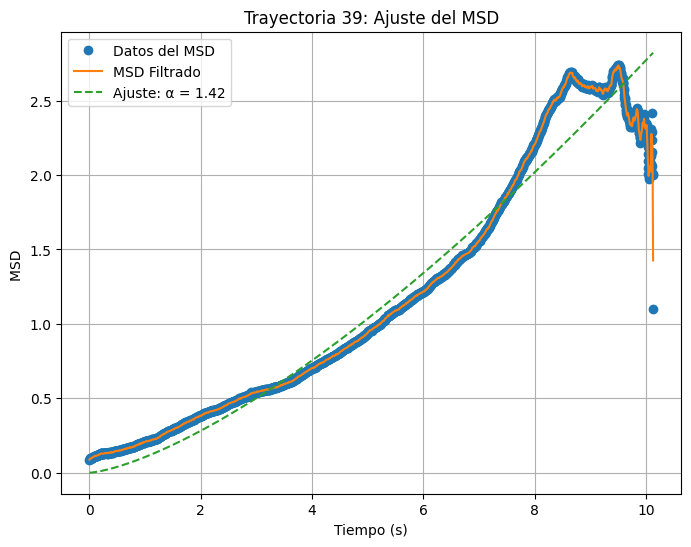

Trayectoria 39: Superdifusivo (α = 1.42)


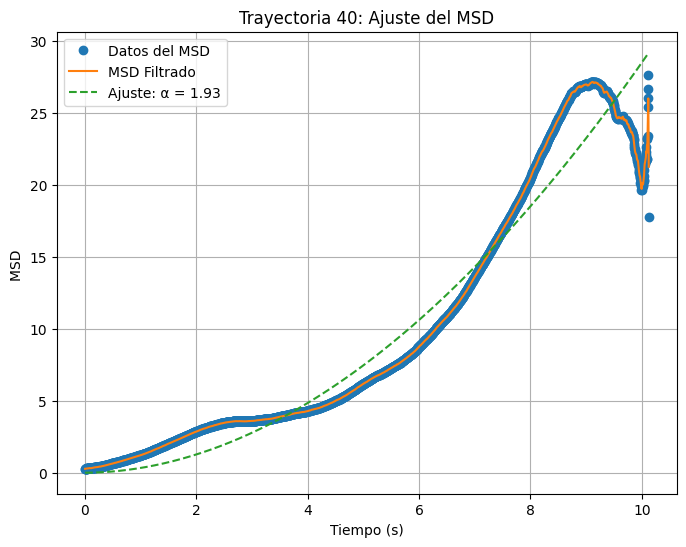

Trayectoria 40: Superdifusivo (α = 1.93)


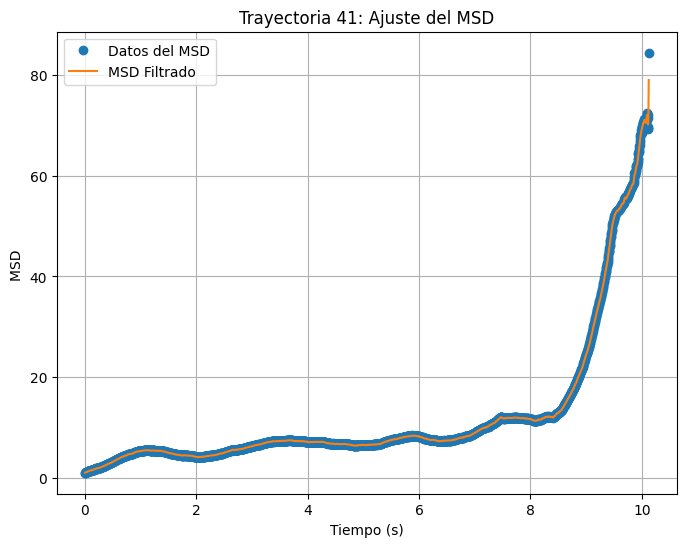

Trayectoria 41: Indeterminado (α = nan)


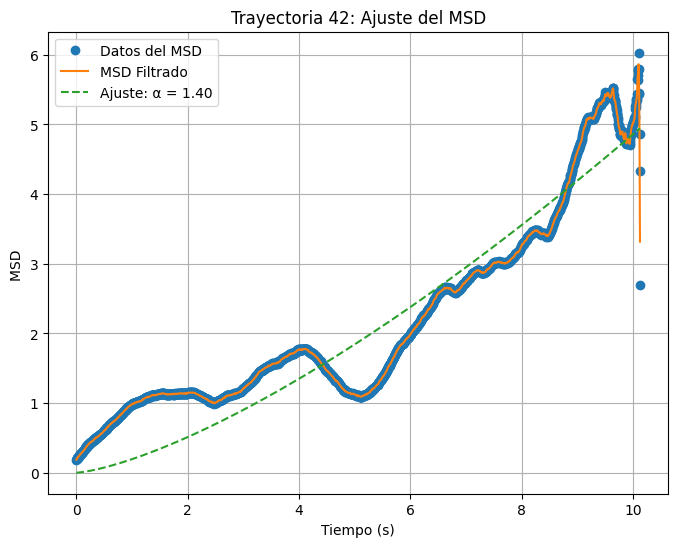

Trayectoria 42: Superdifusivo (α = 1.40)


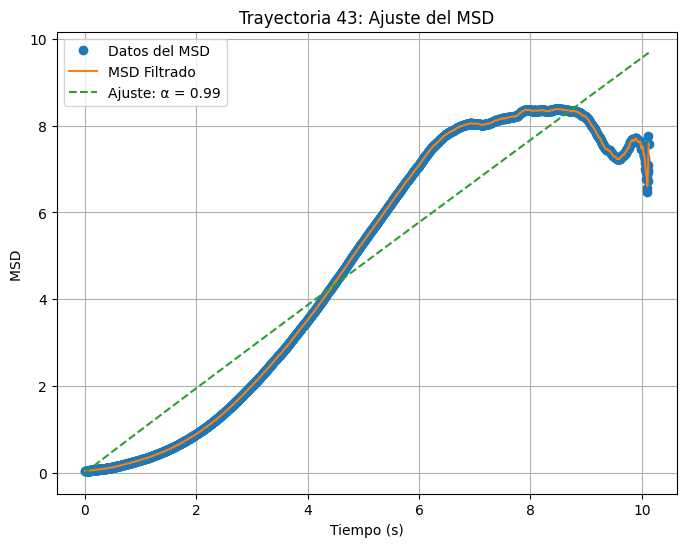

Trayectoria 43: Subdifusivo (α = 0.99)


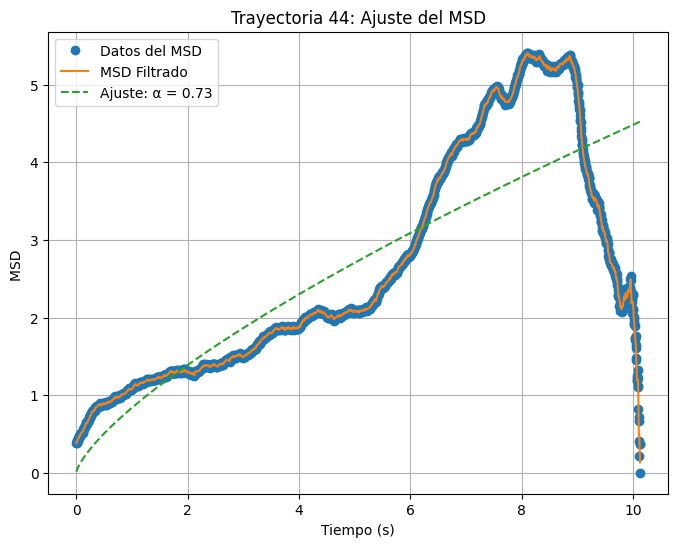

Trayectoria 44: Subdifusivo (α = 0.73)


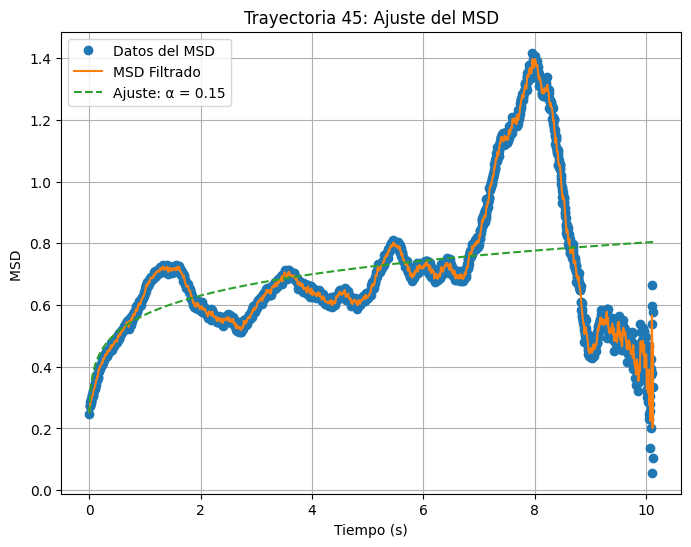

Trayectoria 45: Subdifusivo (α = 0.15)


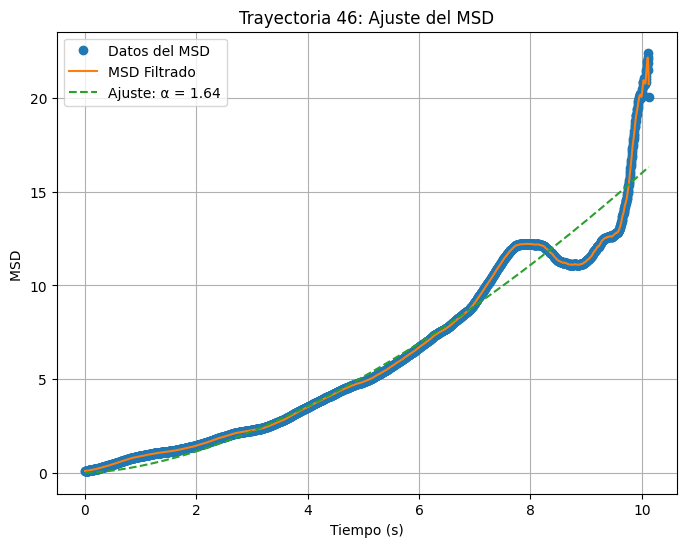

Trayectoria 46: Superdifusivo (α = 1.64)


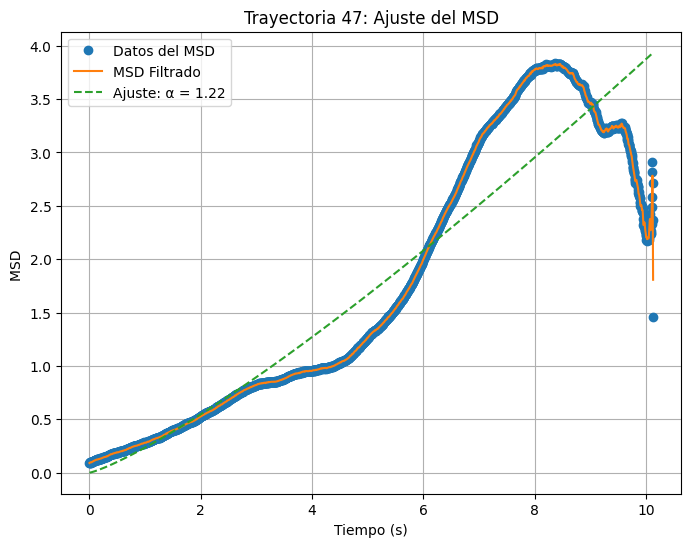

Trayectoria 47: Superdifusivo (α = 1.22)


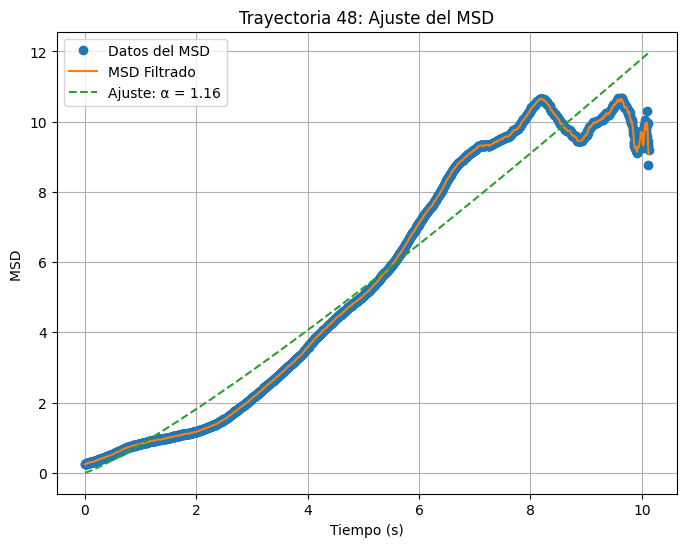

Trayectoria 48: Superdifusivo (α = 1.16)


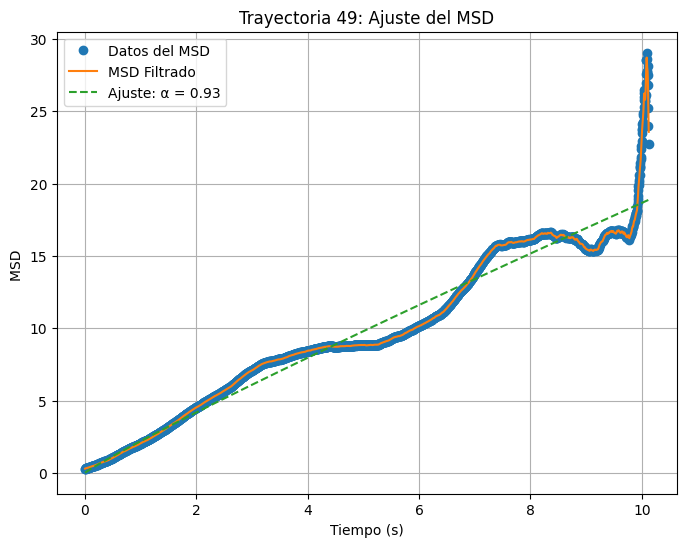

Trayectoria 49: Subdifusivo (α = 0.93)


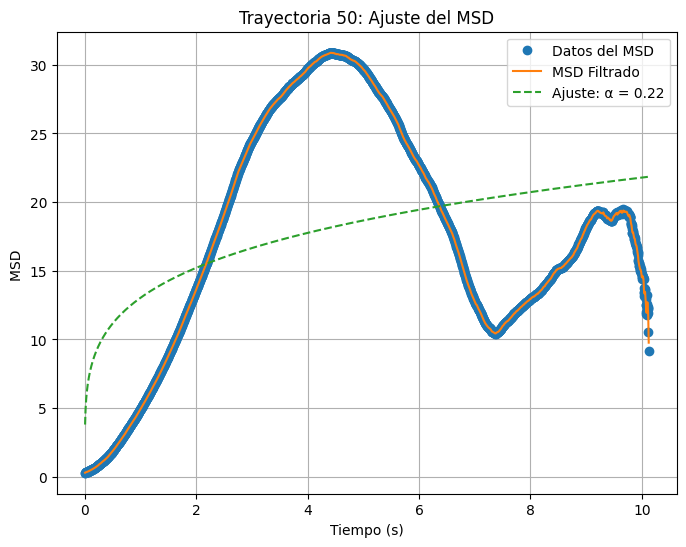

Trayectoria 50: Subdifusivo (α = 0.22)


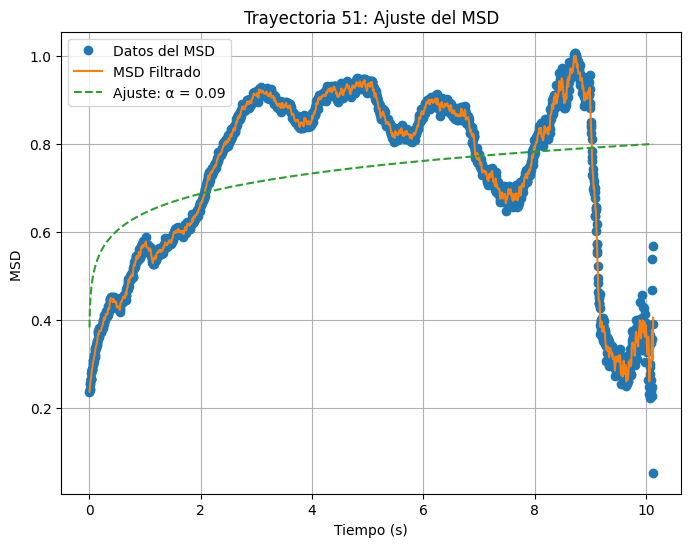

Trayectoria 51: Subdifusivo (α = 0.09)


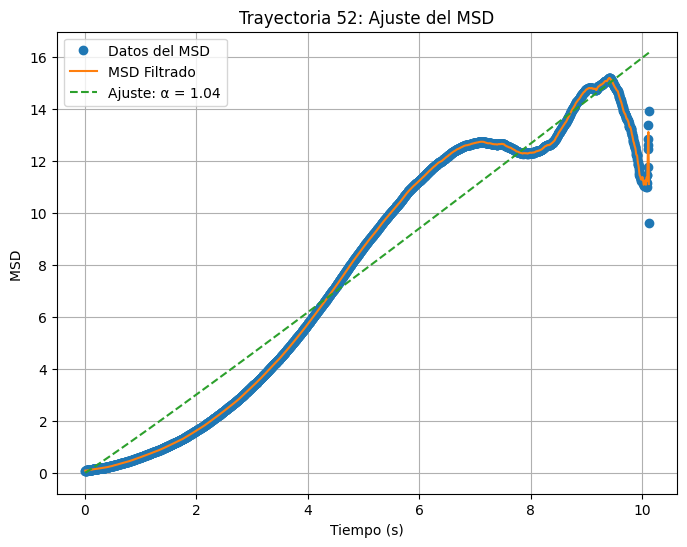

Trayectoria 52: Difusivo normal (α = 1.04)
    Trayectoria  K (Coef. de Difusión)  α (Exponente)    Clasificación
0             0               2.341006       0.553037      Subdifusivo
1             1               1.176166       0.329410      Subdifusivo
2             2               0.507991       0.899393      Subdifusivo
3             3               1.219333       0.444560      Subdifusivo
4             4               0.816561       0.423757      Subdifusivo
5             5               1.410059       1.070676  Difusivo normal
6             6               2.351338       0.142087      Subdifusivo
7             7               0.652548       0.557639      Subdifusivo
8             8               5.407445       0.624573      Subdifusivo
9             9               0.067104       1.836165    Superdifusivo
10           10               0.262299       1.318457    Superdifusivo
11           11               0.027198       2.439847    Superdifusivo
12           12               0.49

In [13]:
n_trayectorias = trajectories.shape[0]
dt = 1 / 250  
resultados_individuales = []

# Individual
for i in range(n_trayectorias):
    trayectoria = trajectories[i, :, 0]  # Seleccionamos la coordenada X para el análisis
    
    # Calcular MSD individual
    tiempos, msd_individual = calcular_msd_individual(trayectoria, dt=dt)
    
    # Aplicar filtro para reducir ruido
    msd_filtrado = gaussian_filter1d(msd_individual, sigma=1)
    
    #ley de potencia
    try:
        popt, _ = curve_fit(ajuste_msd, tiempos, msd_filtrado, p0=[1, 0.5], maxfev=10000)
        K, alpha = popt
        
        # razonables
        if alpha <= 0 or alpha > 3:
            raise ValueError("Exponente α fuera de rango razonable.")
        
    except (RuntimeError, ValueError):
        K, alpha = np.nan, np.nan
    
        # Clasificación según el valor de alpha
    if np.isnan(alpha):
        clas = "Indeterminado"
    elif alpha < 1:
        clas = "Subdifusivo"
    elif np.isclose(alpha, 1, atol=0.1):
        clas = "Difusivo normal"
    else:
        clas = "Superdifusivo"
    

    resultados_individuales.append({
        "Trayectoria": i,
        "K (Coef. de Difusión)": K, #Coeficiente de difusión (intensidad del movimiento)
        "α (Exponente)": alpha, #clasifica mov
        "Clasificación": clas
    })
    
    #MSD individual
    plt.figure(figsize=(8, 6))
    plt.plot(tiempos, msd_individual, 'o', label='Datos del MSD')
    plt.plot(tiempos, msd_filtrado, '-', label='MSD Filtrado')
    if not np.isnan(K) and not np.isnan(alpha):
        plt.plot(tiempos, ajuste_msd(tiempos, *popt), '--', label=f'Ajuste: α = {alpha:.2f}')
    plt.xlabel('Tiempo (s)')
    plt.ylabel('MSD ')
    plt.title(f'Trayectoria {i+1}: Ajuste del MSD')
    plt.legend()
    plt.grid(True)
    plt.show()
    
    print(f"Trayectoria {i+1}: {clas} (α = {alpha:.2f})")

df_resultados = pd.DataFrame(resultados_individuales)
print(df_resultados)
df_resultados.to_csv('resultados_trayectorias_completo.csv', index=False)
print("Resultados guardados en 'resultados_trayectorias_completo.csv'.")



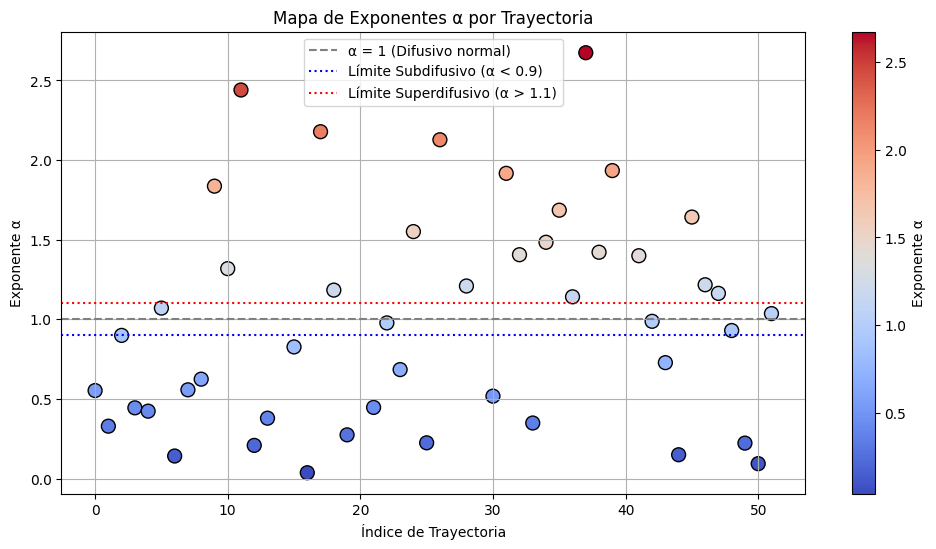

El mapa de exponentes α se ha guardado como 'mapa_exponentes_alpha.png'

 Clasificación de Trayectorias:
Clasificación
Difusivo normal                                              [5, 51]
Indeterminado                                   [14, 20, 27, 29, 40]
Subdifusivo        [0, 1, 2, 3, 4, 6, 7, 8, 12, 13, 15, 16, 19, 2...
Superdifusivo      [9, 10, 11, 17, 18, 24, 26, 28, 31, 32, 34, 35...
Name: Trayectoria, dtype: object


In [14]:
# Mapa de Exponentes α por Trayectoria
alpha_values = df_resultados['α (Exponente)'].values

plt.figure(figsize=(12, 6))
scatter = plt.scatter(
    range(n_trayectorias),
    alpha_values,
    c=alpha_values,
    cmap='coolwarm',
    s=100,
    edgecolors='k'
)
plt.colorbar(scatter, label='Exponente α')
plt.axhline(y=1, color='gray', linestyle='--', label='α = 1 (Difusivo normal)')
plt.axhline(y=0.9, color='blue', linestyle=':', label='Límite Subdifusivo (α < 0.9)')
plt.axhline(y=1.1, color='red', linestyle=':', label='Límite Superdifusivo (α > 1.1)')
plt.xlabel('Índice de Trayectoria')
plt.ylabel('Exponente α')
plt.title('Mapa de Exponentes α por Trayectoria')
plt.legend()
plt.grid(True)
plt.savefig('mapa_exponentes_alpha.png')
plt.show()

print("El mapa de exponentes α se ha guardado como 'mapa_exponentes_alpha.png'")

clasificacion_resumen = df_resultados.groupby("Clasificación")["Trayectoria"].apply(list)
print("\n Clasificación de Trayectorias:")
print(clasificacion_resumen)


